In [ ]:
# Install Cython
!pip install -i https://pypi.tuna.tsinghua.edu.cn/simple Cython

# Install pycocotools
!pip install git+https://github.com/philferriere/cocoapi.git#subdirectory=PythonAPI

Looking in indexes: https://pypi.tuna.tsinghua.edu.cn/simple
  Cloning https://github.com/philferriere/cocoapi.git to /tmp/pip-req-build-2nrfseeq
  Running command git clone --filter=blob:none --quiet https://github.com/philferriere/cocoapi.git /tmp/pip-req-build-2nrfseeq
  Resolved https://github.com/philferriere/cocoapi.git to commit 2929bd2ef6b451054755dfd7ceb09278f935f7ad
  Preparing metadata (setup.py) ... done
  Created wheel for pycocotools: filename=pycocotools-2.0-cp310-cp310-linux_x86_64.whl size=331967 sha256=475479689b323ee5fa21f1798999193ccf7ebad41880aba8996a8a468be60074
  Stored in directory: /tmp/pip-ephem-wheel-cache-1ep7v_kh/wheels/8e/1a/5f/0c984ae3d65a4d7da4ba3407d2a8d8c8e85dd55f84d4936f04
Successfully built pycocotools
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0.6
    Uninstalling pycocotools-2.0.6:
      Successfully uninstalled pycocotools-2.0.6


In [ ]:
from google.colab import drive

# Connect to Google Drive
drive.mount('/content/drive')

# Copy the folder to the Colab environment
!cp -r "/content/drive/MyDrive/9517_augmented" "/content/"

Mounted at /content/drive


In [ ]:
import torch
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.transforms import functional as F
from torch.utils.data import DataLoader
from torchvision.datasets import CocoDetection

In [ ]:
import json
import cv2

For the train_annotations_augmentation file I assume it doesn't include the label. So I insert the label from the train_annotations file given along with the dataset. But it still can run if the new file contains the label. The output was just helping to show the step of process.

In [ ]:
import math
with open('/content/drive/MyDrive/9517_augmented/train_annotations_augmentation','r') as file:
    annotation_train=eval(file.read())
with open('/content/drive/MyDrive/9517_augmented/valid_annotations','r') as file:
    annotation_valid=eval(file.read())
with open('/content/drive/MyDrive/9517_augmented/train_annotations','r') as file:
    annotation=eval(file.read())
data1={}
for i in range(2000):
  annotation_train[i]["category_id"]=annotation[math.floor(i/4)]["category_id"]
data1["annotations"]=annotation_train

images=[]
categories=[]

image_path = "/content/drive/MyDrive/9517_augmented/train/pre_augmentation/"
for i in range(2000):
  print(i)
  imge={}
  cate={}
  img="%d.jpg"%(i)
  image = cv2.imread(image_path+img)
  height,width,_ = image.shape
  imge["id"]=i
  imge["file_name"]=img
  imge["width"]=width
  imge["height"]=height
  images.append(imge)
  id=annotation_train[i]["category_id"]
  if(id==1):
    name="penguin"
  else:
    name="turtle"
  cate["id"]=id
  cate["name"]=name
  categories.append(cate)

data1["images"]=images
data1["categories"]=categories
with open("/content/drive/MyDrive/9517_augmented/train.json", "w") as file:
    json.dump(data1, file)


#image_id_499.jpg

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

For testing on the valid dataset, I didn't use the pre_augmentation one, instead, I use only preprocessed images

In [ ]:
data2={}
'''
for i in range(72):
  annotation_train[i]["category_id"]-=1
'''
data2["annotations"]=annotation_valid

images=[]
categories=[]

image_path = "/content/drive/MyDrive/9517_augmented/valid/preprocess/"
for i in range(72):
  imge={}
  cate={}
  img="%d.jpg"%(i)

  image = cv2.imread(image_path+img)
  height,width,_ = image.shape
  imge["id"]=i
  imge["file_name"]=img
  imge["width"]=width
  imge["height"]=height
  images.append(imge)
  id=annotation_valid[i]["category_id"]
  if(id==1):
    name="penguin"
  else:
    name="turtle"
  cate["id"]=id
  cate["name"]=name
  categories.append(cate)

data2["images"]=images
data2["categories"]=categories
with open("/content/drive/MyDrive/9517_augmented/valid.json", "w") as file:
    json.dump(data2, file)

In [ ]:
from torchvision import transforms as T
import torchvision.datasets as datasets
from torchvision.transforms import functional as F
import random
import numpy as np

font=cv2.FONT_HERSHEY_SIMPLEX
def collate_fn_coco(batch):
  return tuple(zip(*batch))

class Compose(object):
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, target):
        for t in self.transforms:
            image = t(image)
            for obj in target:
                obj['bbox'] = torch.tensor(np.array(obj['bbox']))
        return image, target

transform=Compose([T.ToTensor()])
# Define your dataset and dataloader
train_dataset = CocoDetection(root='/content/drive/MyDrive/9517_augmented/train/pre_augmentation', annFile='/content/drive/MyDrive/9517_augmented/train.json', transforms=transform)

train_sampler=torch.utils.data.RandomSampler(train_dataset)
batch_sampler=torch.utils.data.BatchSampler(train_sampler,5,drop_last=True)
dataloader = DataLoader(train_dataset, batch_sampler=batch_sampler, num_workers=2,collate_fn=collate_fn_coco)
'''
test_dataset = CocoDetection(root='/content/drive/MyDrive/9517project/valid/preprocess', annFile='/content/drive/MyDrive/9517project/valid.json', transforms=transform)
test_dataloader = DataLoader(test_dataset, batch_size=2, shuffle=True, num_workers=2)
'''

loading annotations into memory...
Done (t=0.16s)
creating index...
index created!


"\ntest_dataset = CocoDetection(root='/content/drive/MyDrive/9517project/valid_augmentation', annFile='/content/drive/MyDrive/9517project/valid.json', transforms=transform)\ntest_dataloader = DataLoader(test_dataset, batch_size=2, shuffle=True, num_workers=2)\n"

In [ ]:
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

The following block is to show what "true bounding boxes" of the train_dataset are like

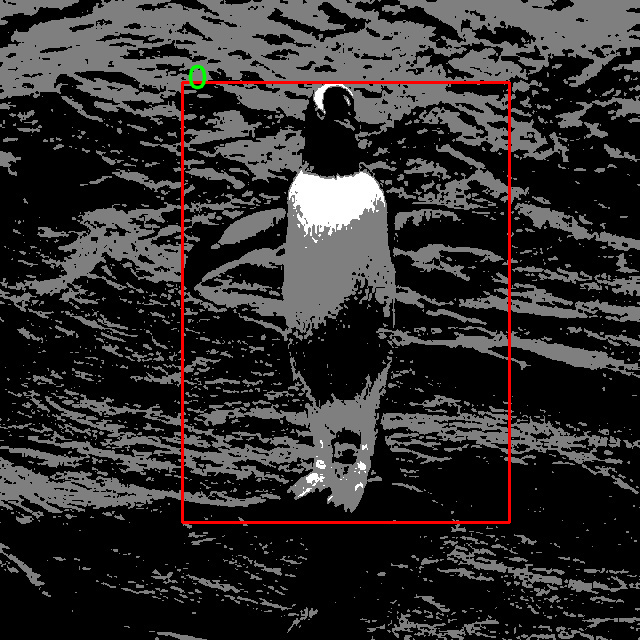

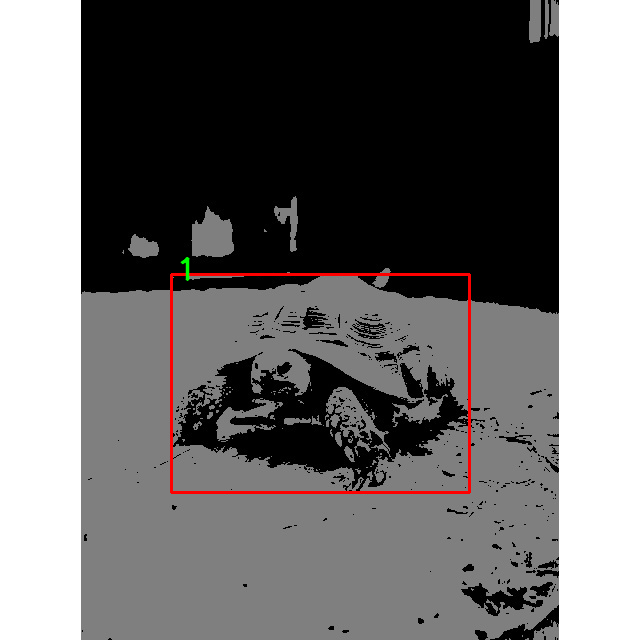

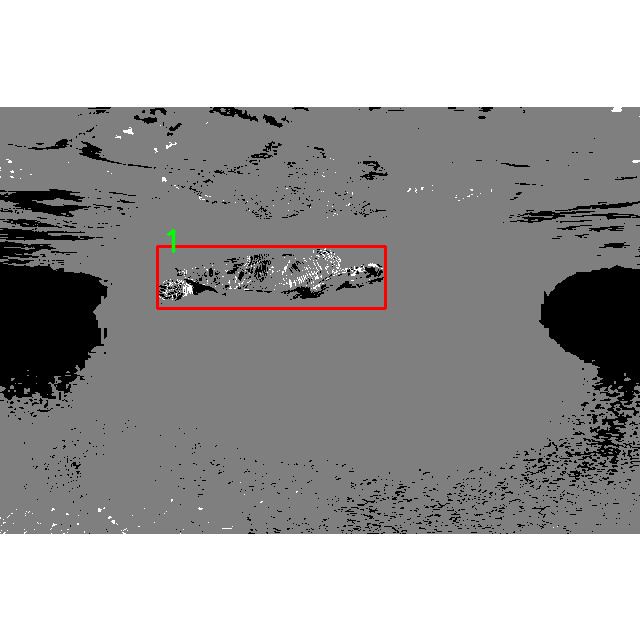

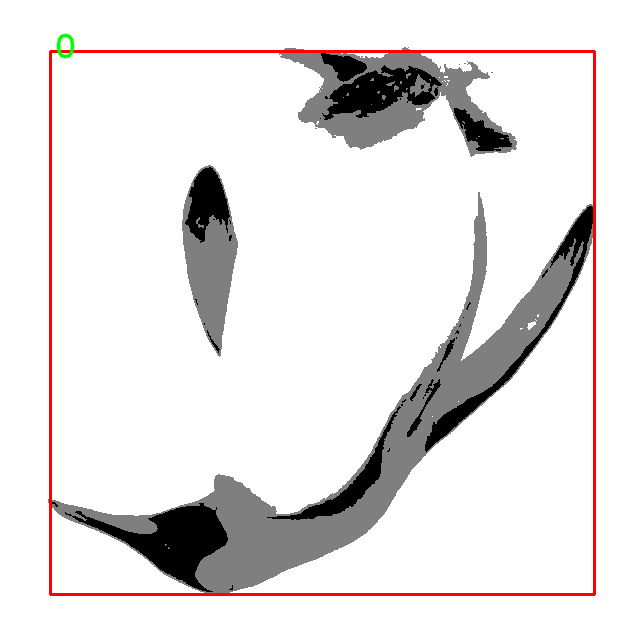

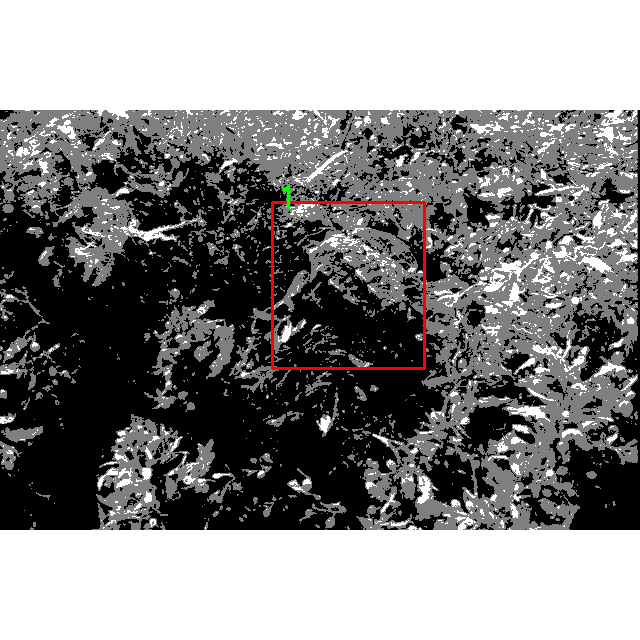

...

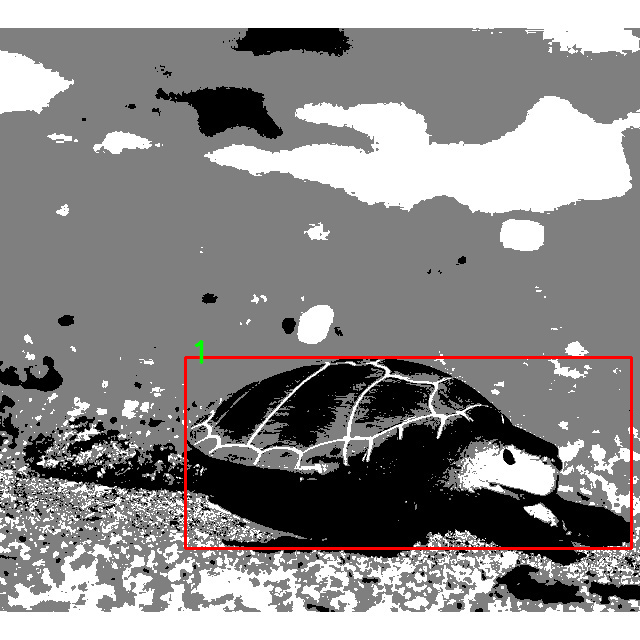

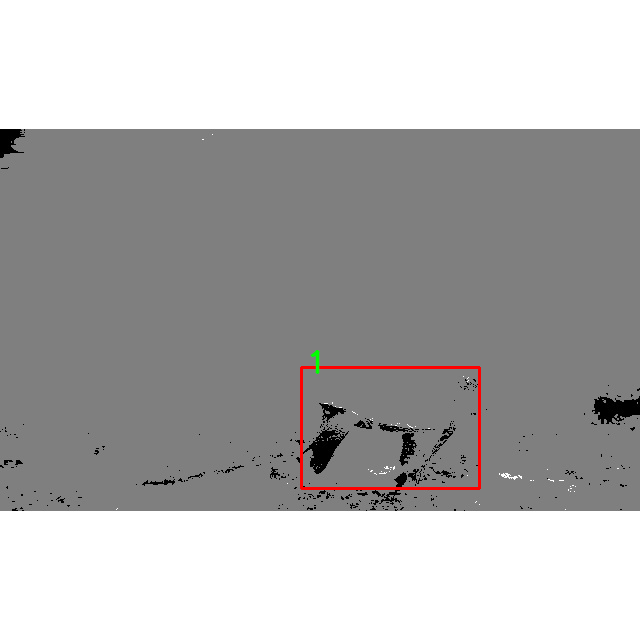

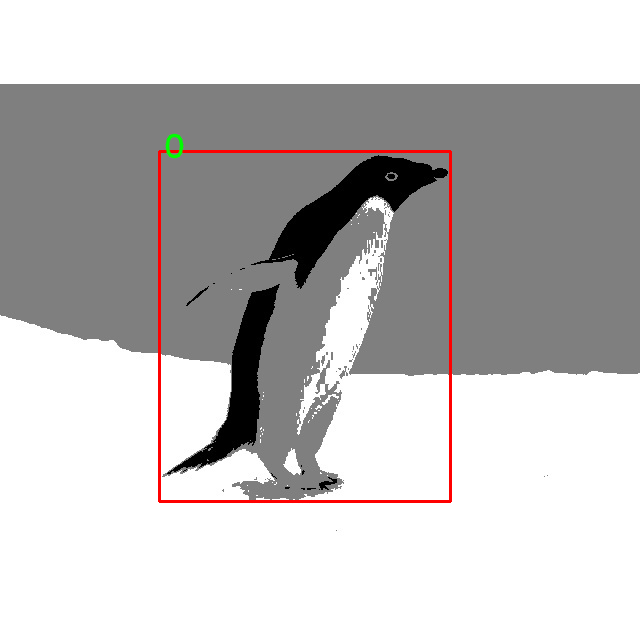

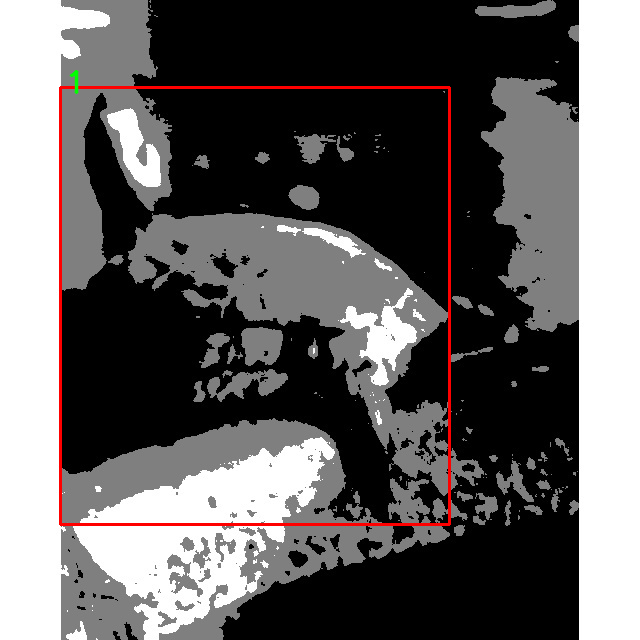

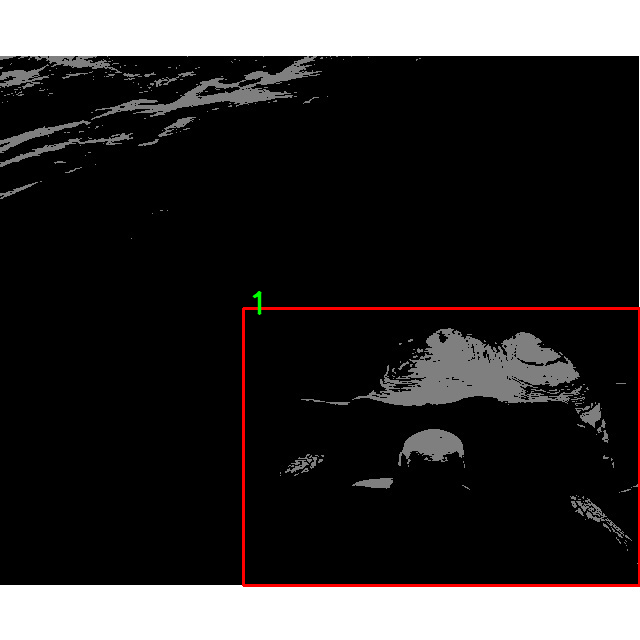

KeyboardInterrupt: ignored

In [ ]:
#Visible for true bbox
for imgs,labels in dataloader:
    for i in range(1):#len(imgs)
        bboxes = []
        ids = []
        img = imgs[i]
        labels_ = labels[i]
        for label in labels_:

          bboxes.append([label['bbox'][0],
          label['bbox'][1],
          label['bbox'][0] + label['bbox'][2],
          label['bbox'][1] + label['bbox'][3]

          ])


          ids.append(label['category_id'])

        img = img.permute(1,2,0).numpy()
        img = (img * 255).astype(np.uint8)
        img = cv2.cvtColor(img,cv2.COLOR_RGB2BGR)

        for box ,id_ in zip(bboxes,ids):
          x1 = int(box[0])
          y1 = int(box[1])
          x2 = int(box[2])
          y2 = int(box[3])
          cv2.rectangle(img,(x1,y1),(x2,y2),(0,0,255),thickness=2)
          cv2.putText(img, text=str(id_), org=(x1 + 5, y1 + 5), fontFace=font, fontScale=1,
              thickness=2, lineType=cv2.LINE_AA, color=(0, 255, 0))
        cv2_imshow(img)
        cv2.waitKey()




In [ ]:
#This block doesn't need to be run, just in case if you need to clear the cache
'''
import torch


torch.cuda.empty_cache()
''

In [ ]:
import torchvision.models as models
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
import torchvision.ops as ops

# Load pre-trained Faster R-CNN model
backbone = models.mobilenet_v2(pretrained=True).features
backbone.out_channels = 1280
roi_pooler =ops.MultiScaleRoIAlign(featmap_names=['0', '1'], output_size=7, sampling_ratio=2)
#model = FasterRCNN(backbone=backbone, num_classes=3, rpn_anchor_generator=AnchorGenerator(sizes=((128, 256, 512),), aspect_ratios=((0.5, 1.0, 2.0),)),box_detections_per_img=1,box_roi_pool=roi_pooler)
model = FasterRCNN(backbone=backbone,rpn_nms_thresh=0.6, rpn_fg_iou_thresh=0.6, rpn_bg_iou_thresh=0.3, num_classes=3, rpn_positive_fraction=1,rpn_anchor_generator=AnchorGenerator(sizes=((5,10,32,64,128,256,512,800,1024,2000,2500,3000,3500,4000,4500,5000,6000,10000,14000,16000,20000,30000,50000,100000,150000,200000,400000),), aspect_ratios=((0.1,0.3,0.5,0.8,1.0,1.25,1.5,2.0,2.5,3.0,3.5,4.0,4.5,5,5.5,6),)),box_detections_per_img=300,box_roi_pool=roi_pooler)


# Define your optimizer and loss function
optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.8)
#criterion = torch.nn.CrossEntropyLoss()

In [ ]:
from torchvision.models.detection import FasterRCNN
help(FasterRCNN)

Help on class FasterRCNN in module torchvision.models.detection.faster_rcnn:

class FasterRCNN(torchvision.models.detection.generalized_rcnn.GeneralizedRCNN)
 |  FasterRCNN(backbone, num_classes=None, min_size=800, max_size=1333, image_mean=None, image_std=None, rpn_anchor_generator=None, rpn_head=None, rpn_pre_nms_top_n_train=2000, rpn_pre_nms_top_n_test=1000, rpn_post_nms_top_n_train=2000, rpn_post_nms_top_n_test=1000, rpn_nms_thresh=0.7, rpn_fg_iou_thresh=0.7, rpn_bg_iou_thresh=0.3, rpn_batch_size_per_image=256, rpn_positive_fraction=0.5, rpn_score_thresh=0.0, box_roi_pool=None, box_head=None, box_predictor=None, box_score_thresh=0.05, box_nms_thresh=0.5, box_detections_per_img=100, box_fg_iou_thresh=0.5, box_bg_iou_thresh=0.5, box_batch_size_per_image=512, box_positive_fraction=0.25, bbox_reg_weights=None, **kwargs)
 |  
 |  Implements Faster R-CNN.
 |  
 |  The input to the model is expected to be a list of tensors, each of shape [C, H, W], one for each
 |  image, and should be in

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.train()
model=model.to(device)
# Training loop
for epoch in range(1):
  for images, targets in dataloader:
    # Preprocess the images and targets
    images = [image.to(device) for image in images]
    targets=[target[0] for target in targets]
    for target in targets:
      xmin,ymin,width,height=target["bbox"]
      ymax=ymin+height
      xmax=xmin+width
      target["boxes"]=torch.tensor(np.expand_dims(np.array([xmin,ymin,xmax,ymax]),axis=0)).to(device)
      target["labels"]=torch.tensor(np.expand_dims(np.array(target["category_id"]),axis=0)).to(device)



    # Forward pass
    optimizer.zero_grad()
    losses = model(images, targets)
    total_loss = sum(loss for loss in losses.values())

    # Backpropagation
    total_loss.backward()

    # Update the parameters
    optimizer.step()

    # Print the loss
    print(f"Epoch: {epoch+1}, Loss: {total_loss.item()}")


Epoch: 1, Loss: 1.9744590520858765
Epoch: 1, Loss: 0.9644923210144043
Epoch: 1, Loss: 0.9060254693031311
Epoch: 1, Loss: 0.9381251335144043
Epoch: 1, Loss: 0.8167871236801147
Epoch: 1, Loss: 1.1597766876220703
Epoch: 1, Loss: 0.95747971534729
Epoch: 1, Loss: 1.0119283199310303
Epoch: 1, Loss: 1.2440311908721924
Epoch: 1, Loss: 0.8677783012390137
Epoch: 1, Loss: 0.9613838791847229
Epoch: 1, Loss: 1.3018670082092285
Epoch: 1, Loss: 0.9127999544143677
Epoch: 1, Loss: 0.7827510833740234
Epoch: 1, Loss: 0.8186782598495483
Epoch: 1, Loss: 1.0415384769439697
Epoch: 1, Loss: 1.0327682495117188
Epoch: 1, Loss: 0.9456064701080322
Epoch: 1, Loss: 0.8621068000793457
Epoch: 1, Loss: 0.7068382501602173
Epoch: 1, Loss: 0.750339150428772
Epoch: 1, Loss: 0.7930124402046204
Epoch: 1, Loss: 0.8134147524833679
Epoch: 1, Loss: 0.7397347092628479
Epoch: 1, Loss: 0.8841584324836731
Epoch: 1, Loss: 0.8591461777687073
Epoch: 1, Loss: 0.7590416669845581
Epoch: 1, Loss: 0.8025614023208618
Epoch: 1, Loss: 0.82984

'\n  predictions = model(images)\n  targets=[target[0] for target in targets]\n  for target in targets:\n    xmin,ymin,width,height=target["bbox"]\n    ymax=ymin+height\n    xmax=xmin+width\n    target["boxes"]=torch.tensor(np.expand_dims(np.array([xmin,ymin,xmax,ymax]),axis=0))\n    target["labels"]=torch.tensor(np.expand_dims(np.array(target["category_id"]),axis=0))\n  boxes=[prediction["boxes"]for prediction in predictions]\n  labelss=[prediction["labels"]for prediction in predictions]\n  for i in range(len(boxes)):\n    boxes[i]=boxes[i][0]\n    labelss[i]=labelss[i][0]\n  loss=loss_cul(boxes,targets)\n  #loss = sum(criterion(box, target[\'bbox\']) for box, target in zip(boxes, targets))\n  print(f"Loss: {loss.item()}")\n  for i in range(len(images)):#72\n    img=images[i]\n    target=targets[i]\n    img = img.permute(1,2,0).numpy()\n    img = (img * 255).astype(np.uint8)\n    img = cv2.cvtColor(img,cv2.COLOR_RGB2BGR)\n    id=labelss[i]\n    box=boxes[i]\n    x1 = int(box[0])\n    

The following block shows the performance of our Faster-RCNN on the augmented training set.

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loss: 374.26983642578125


<ipython-input-28-adf1cefca471>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target["bbox"]=torch.tensor(target["bbox"]).to(device)


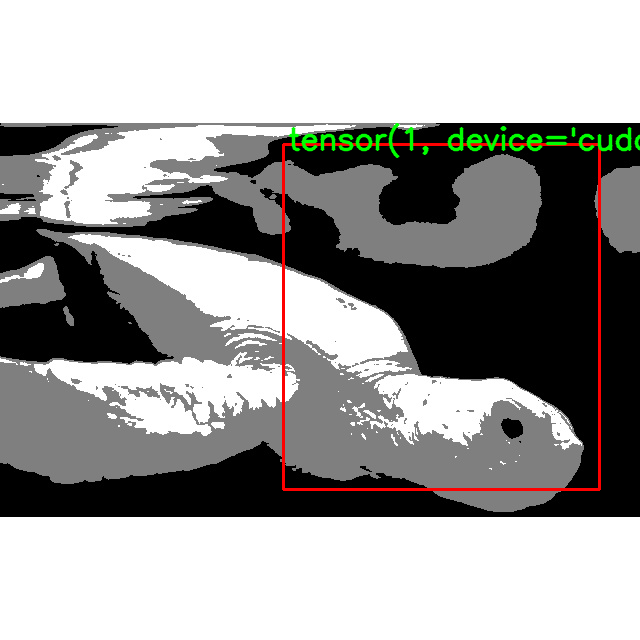

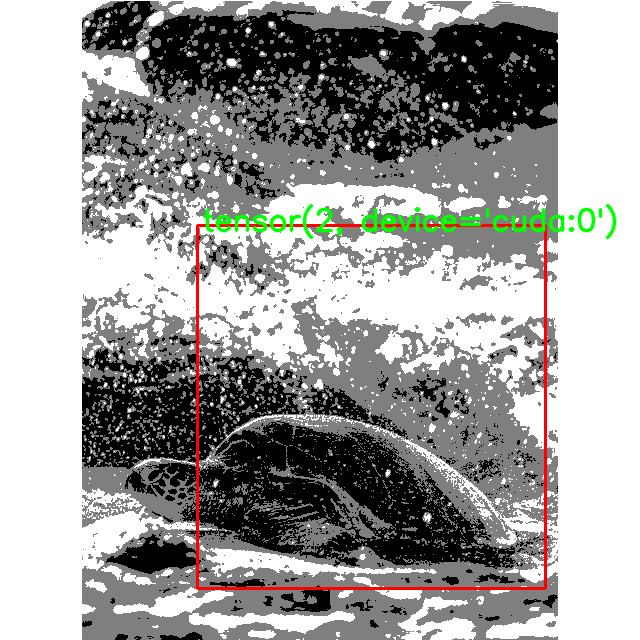

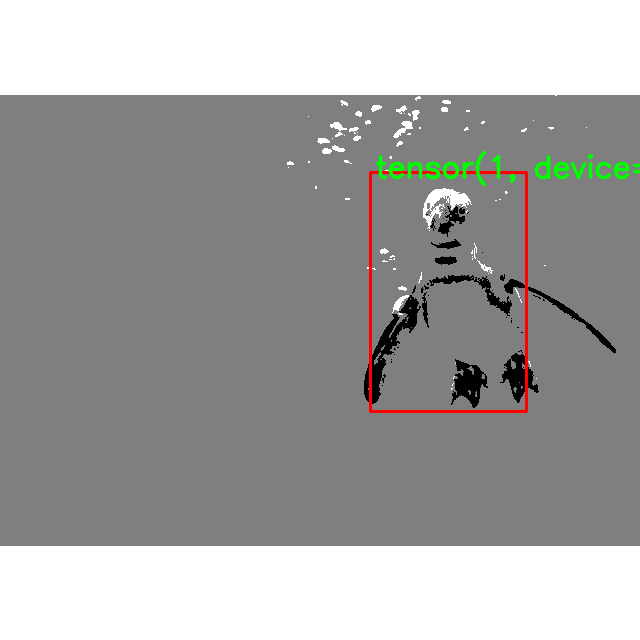

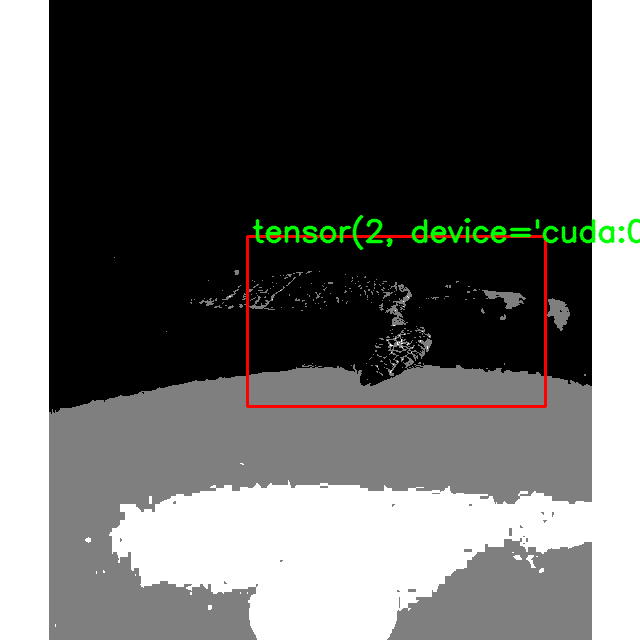

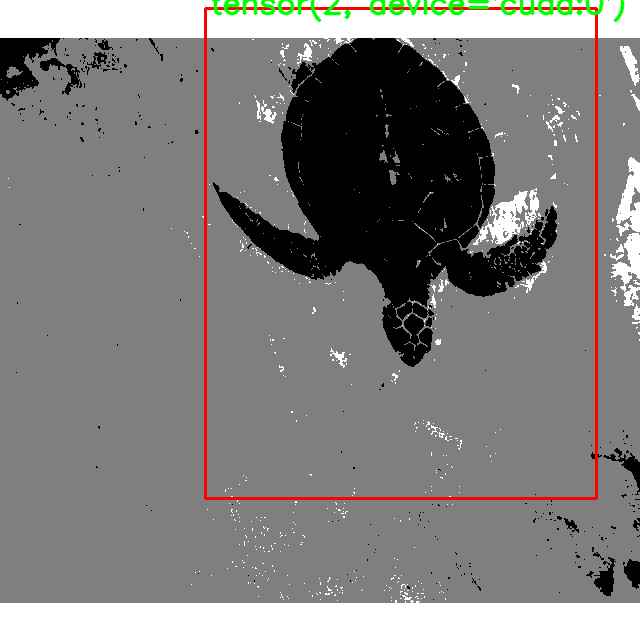

Loss: 295.8474426269531


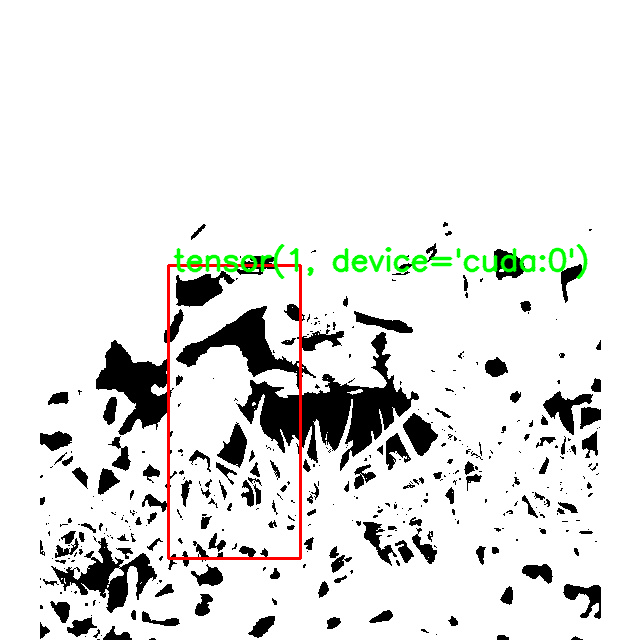

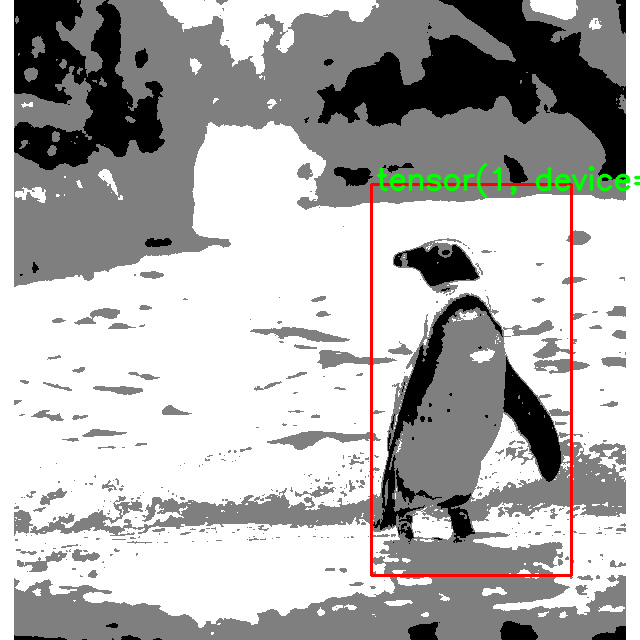

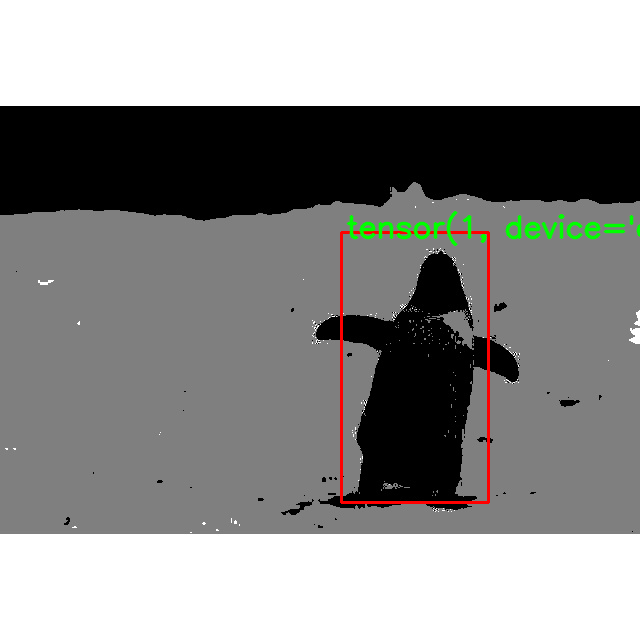

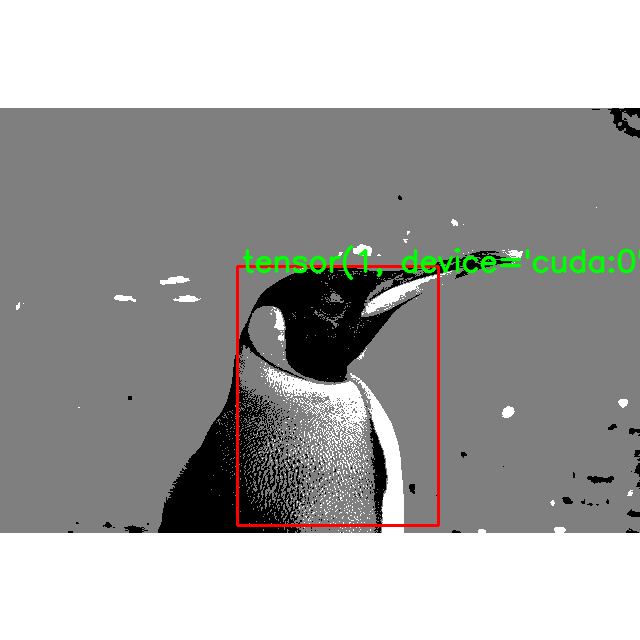

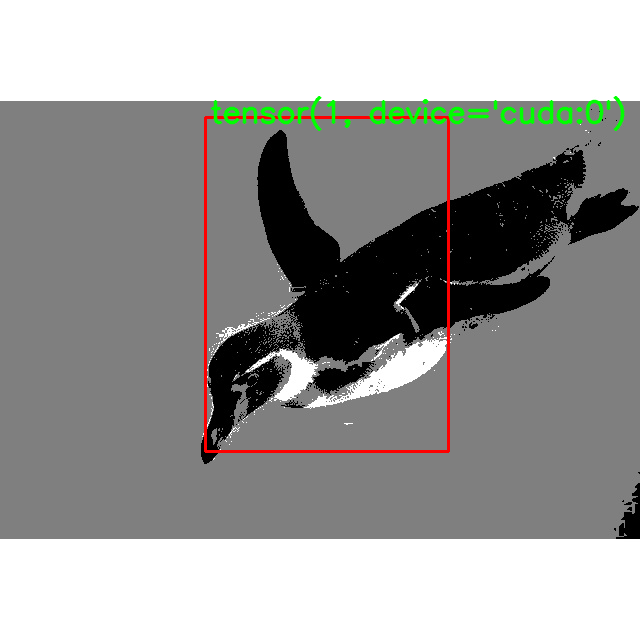

Loss: 348.043212890625


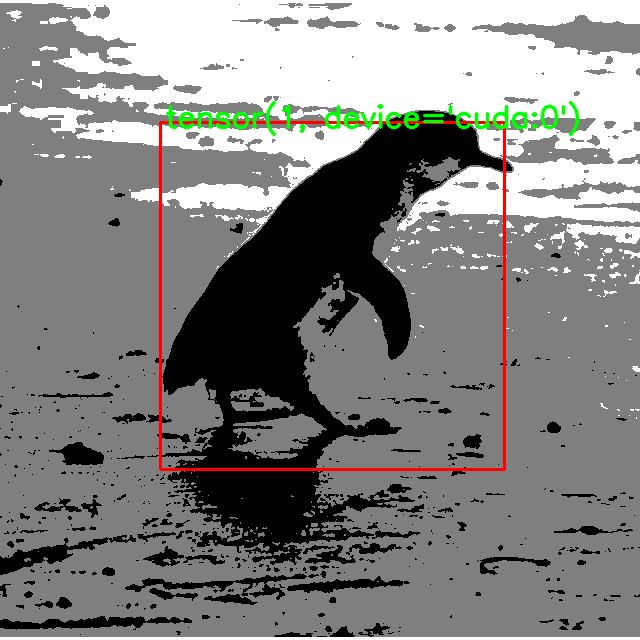

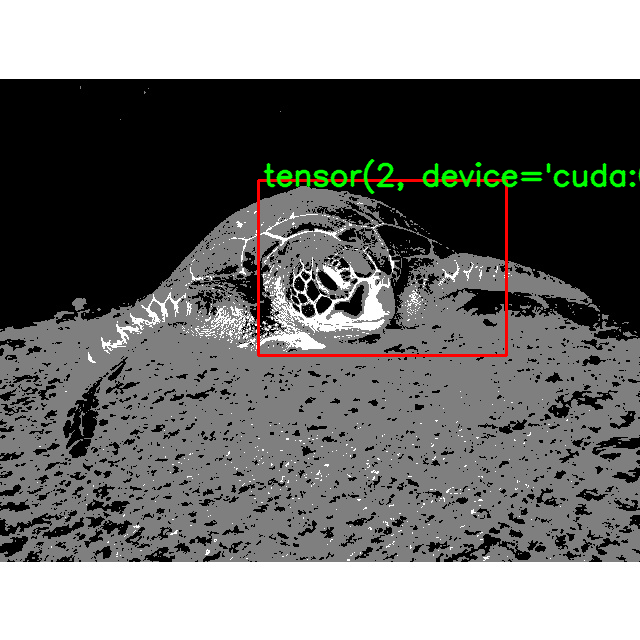

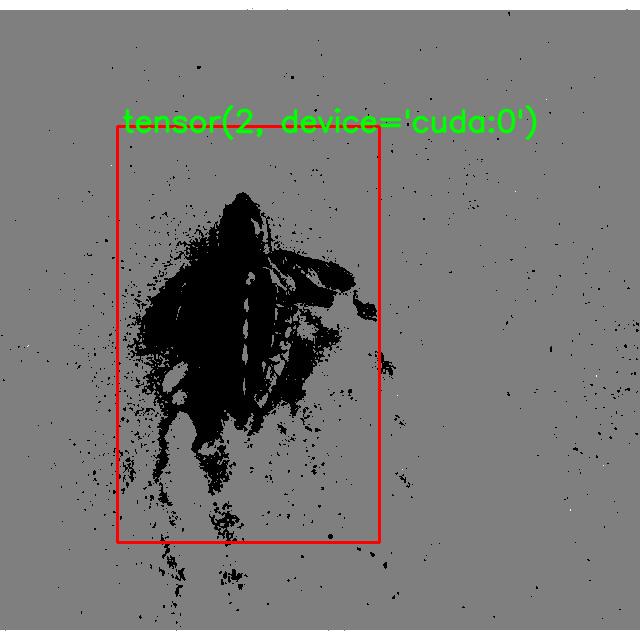

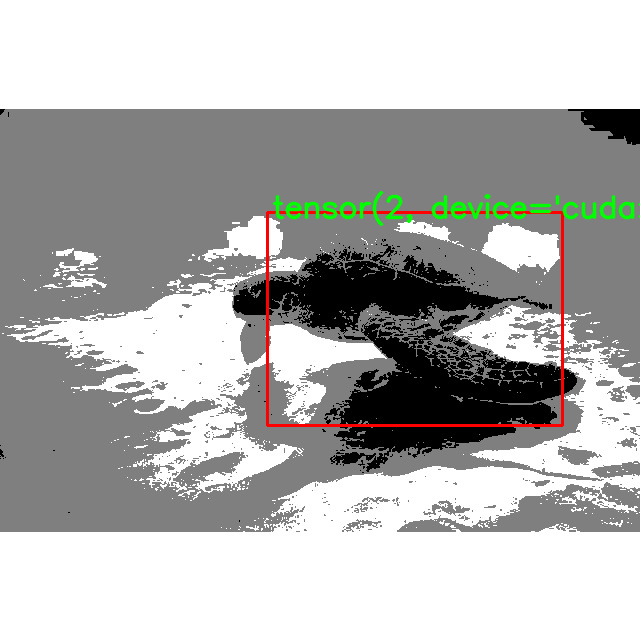

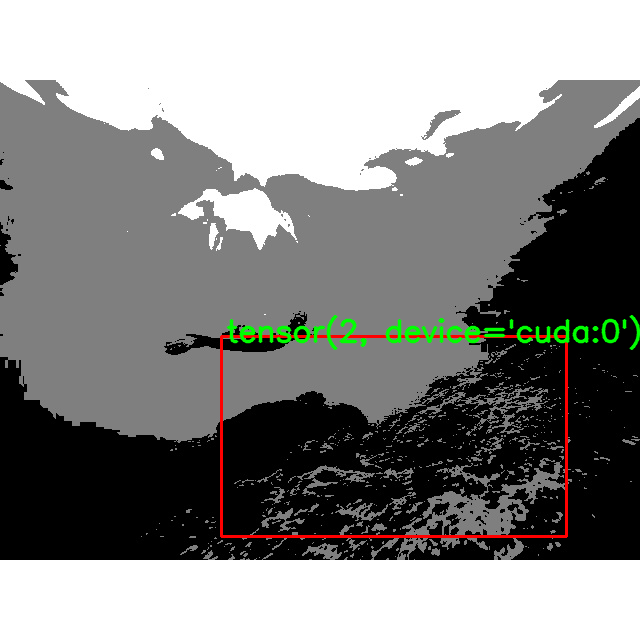

Loss: 296.90948486328125


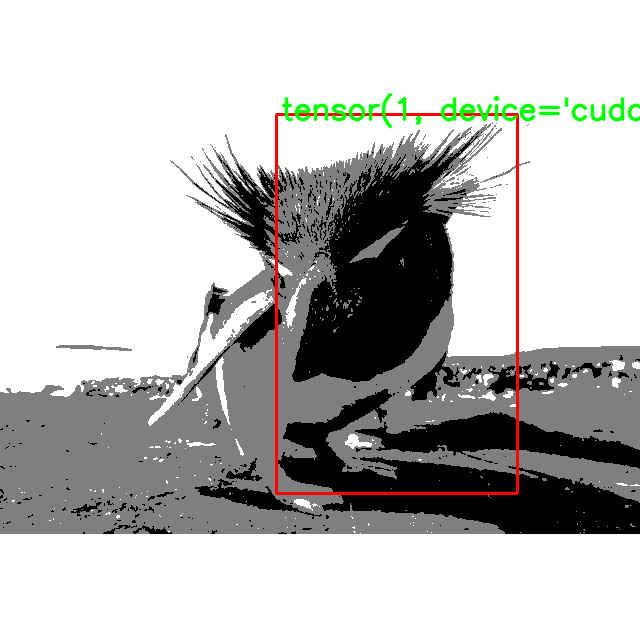

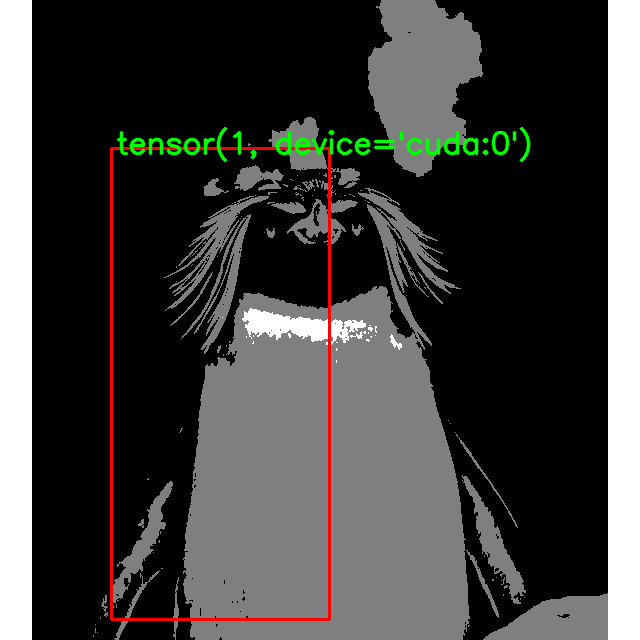

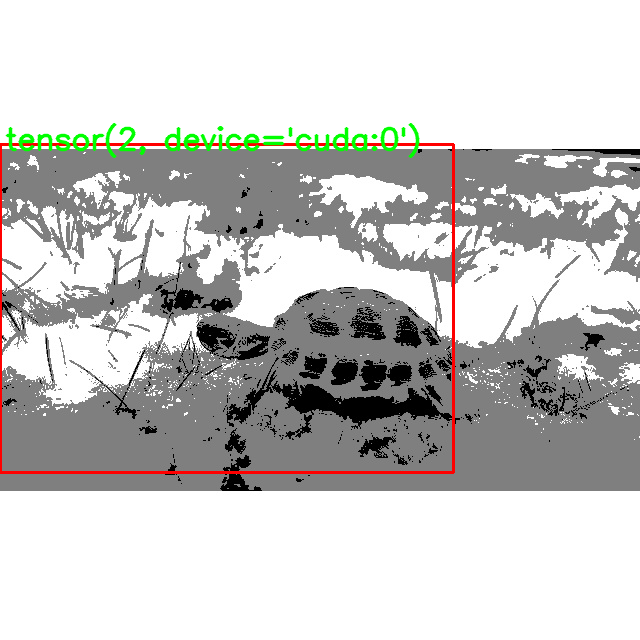

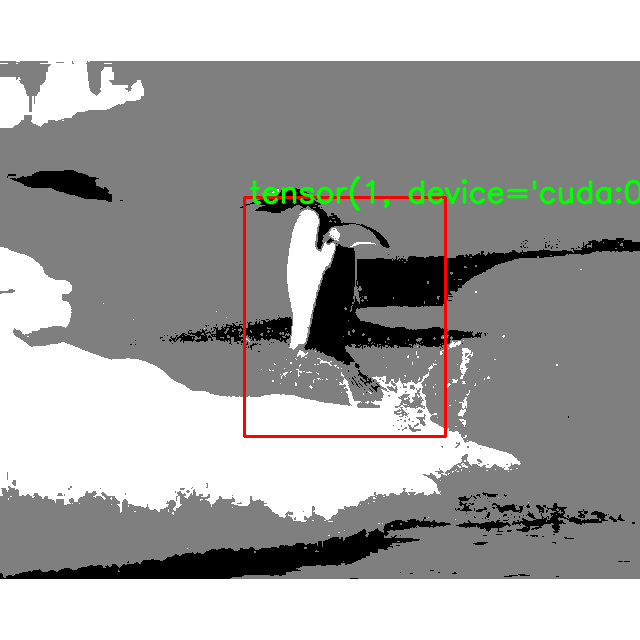

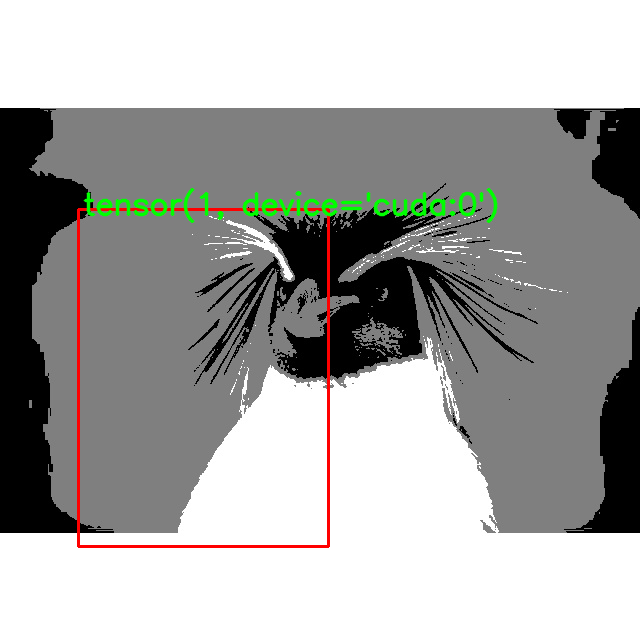

Loss: 311.4445495605469


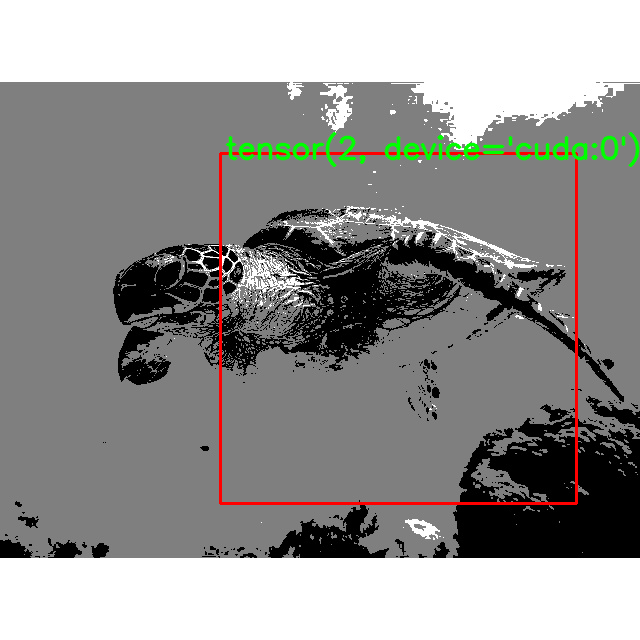

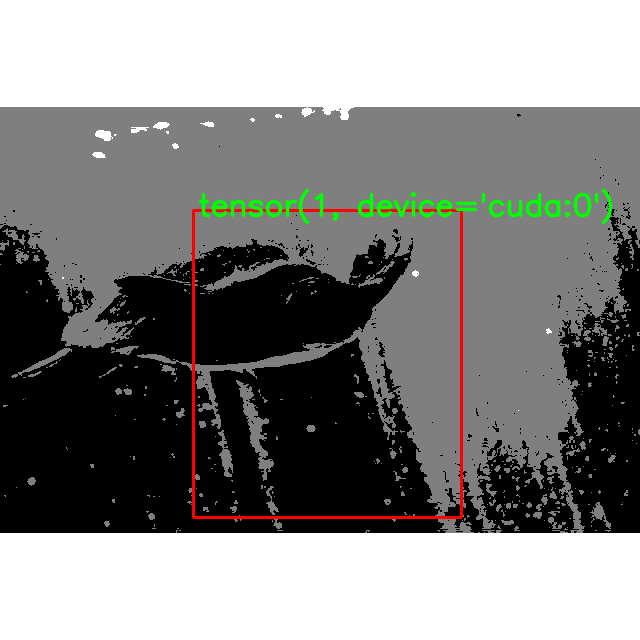

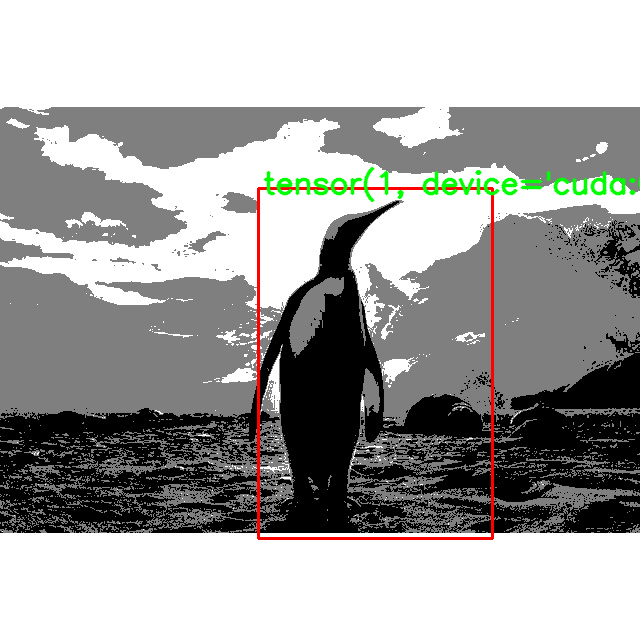

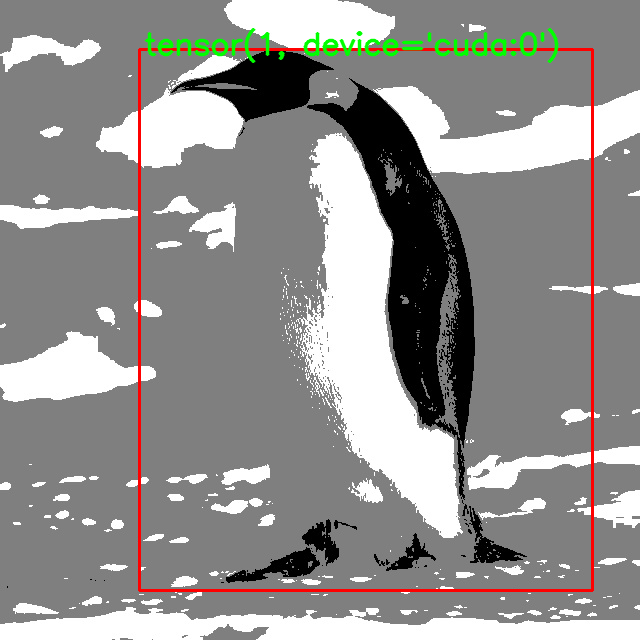

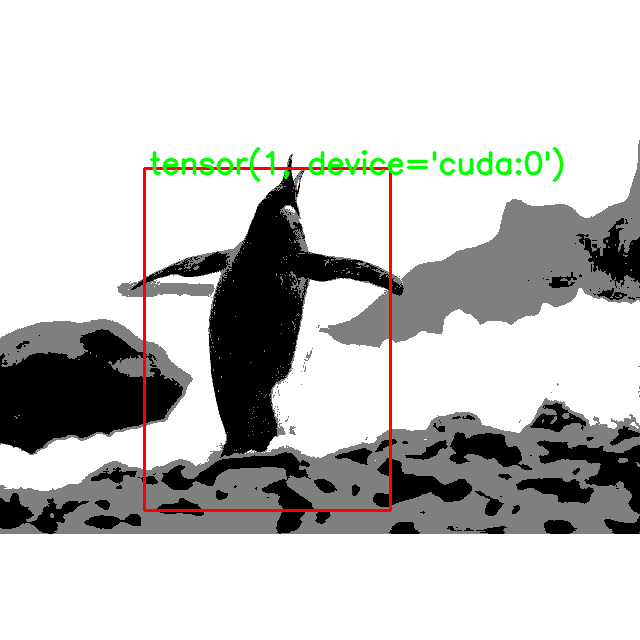

Loss: 181.87510681152344


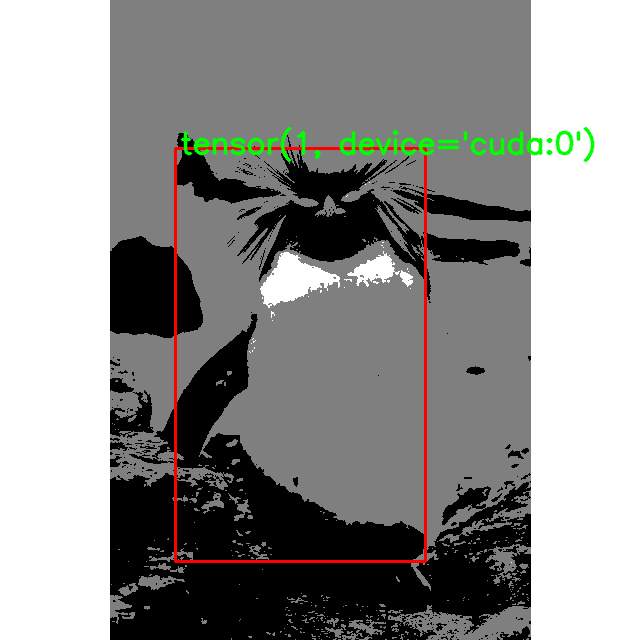

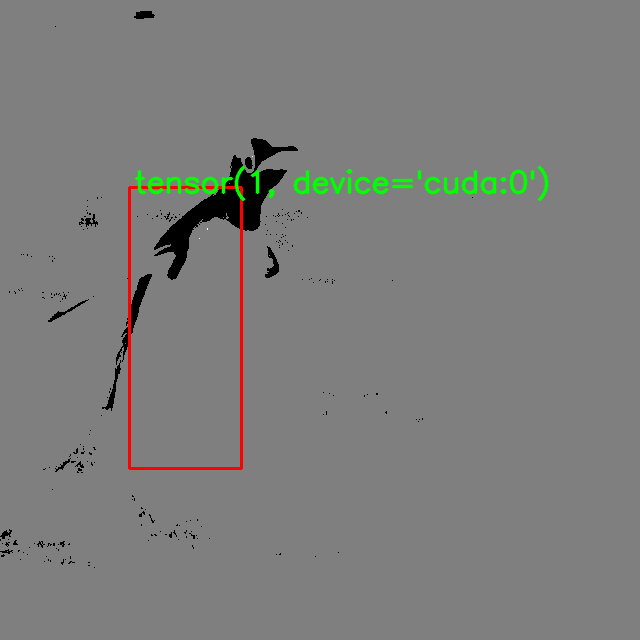

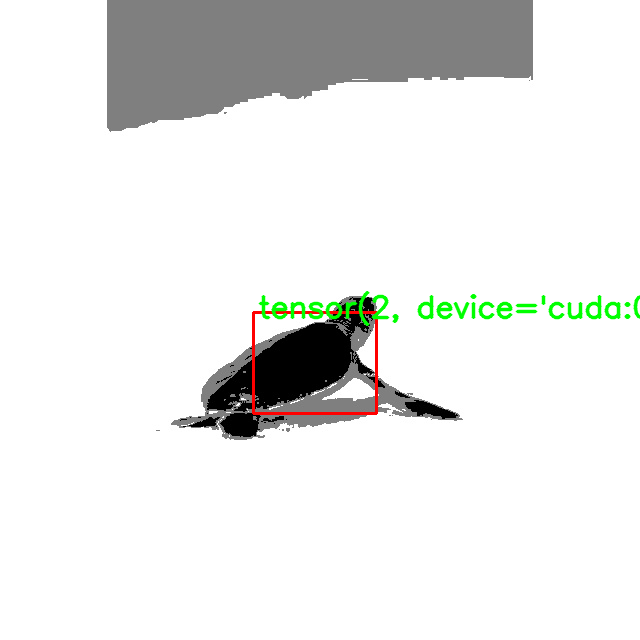

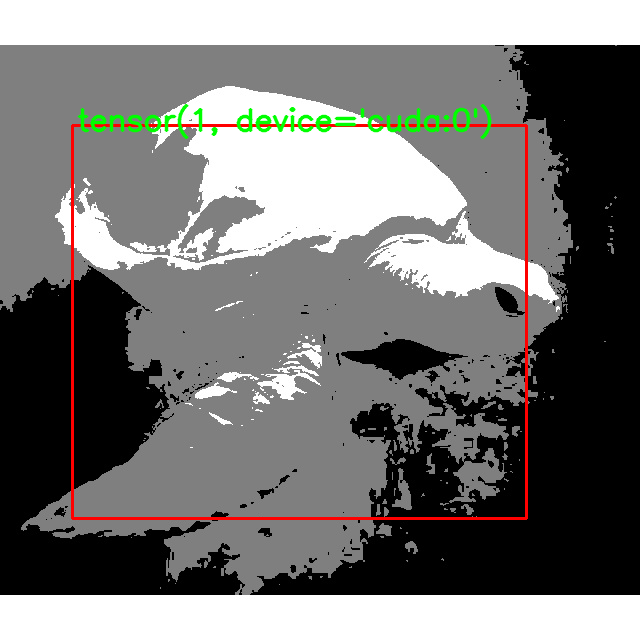

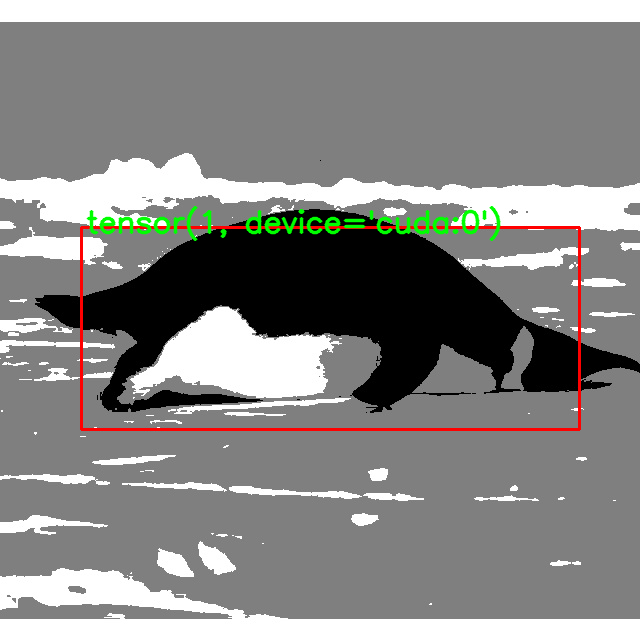

Loss: 301.72540283203125


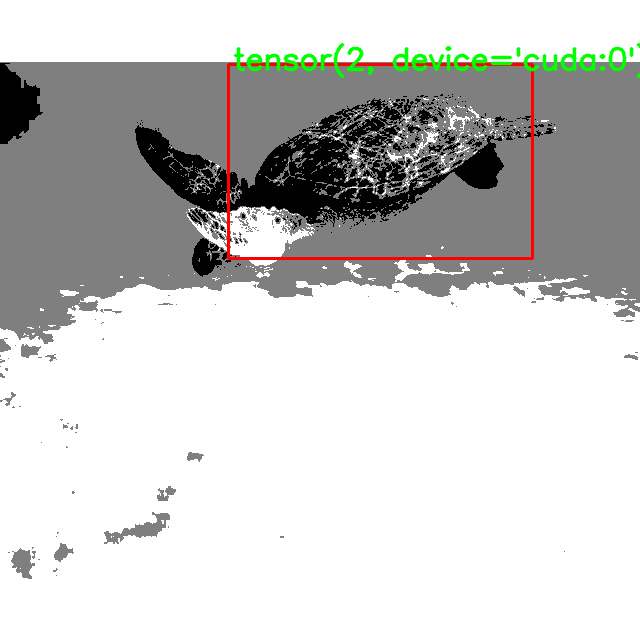

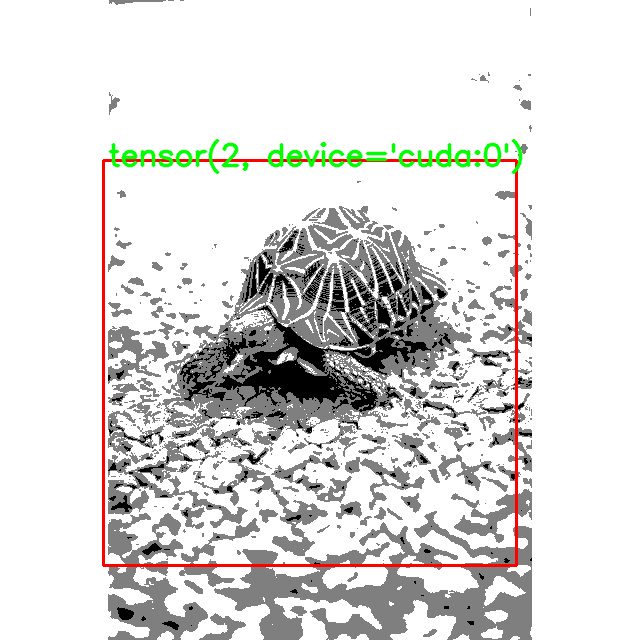

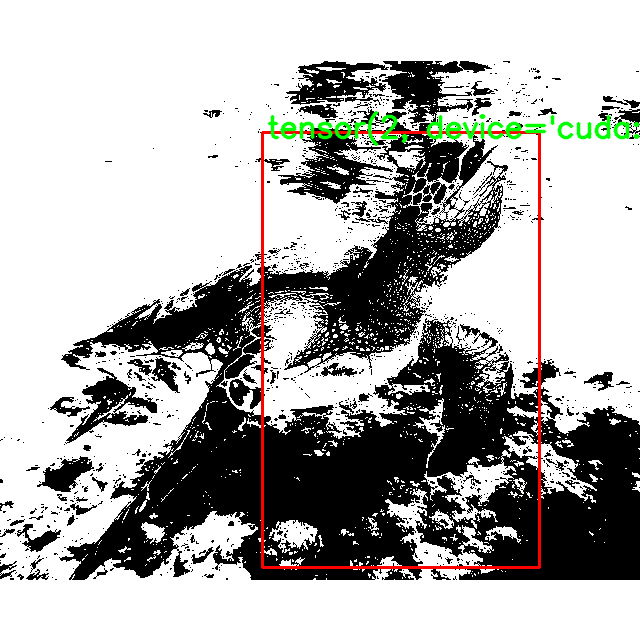

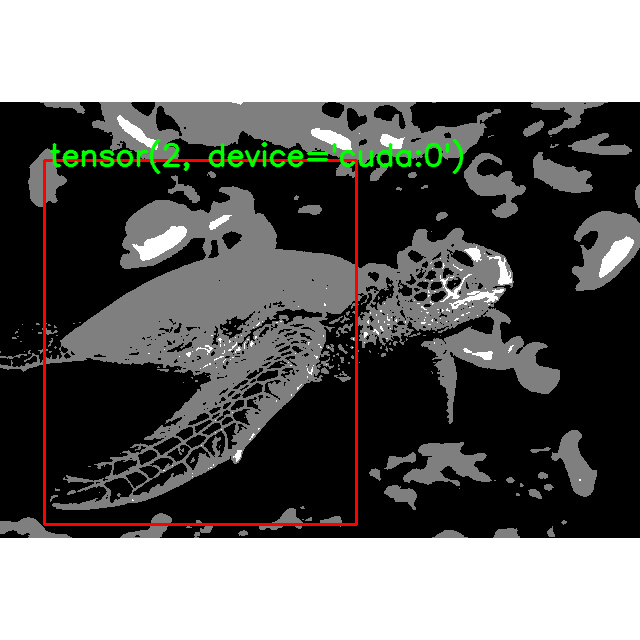

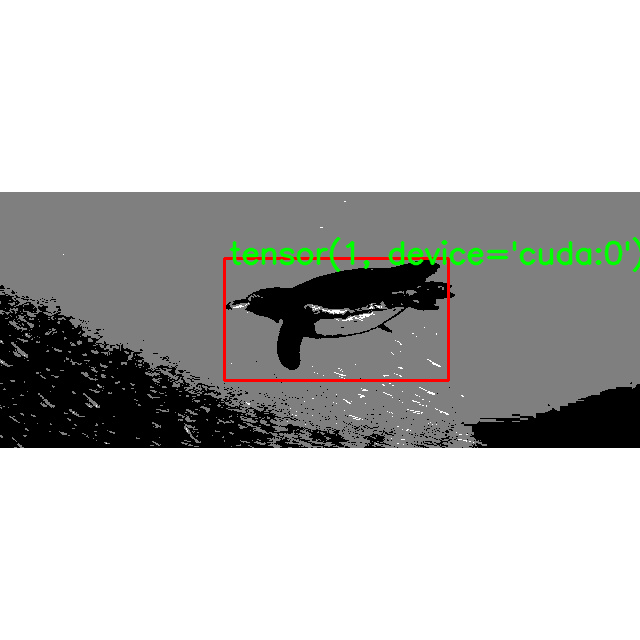

Loss: 283.5045471191406


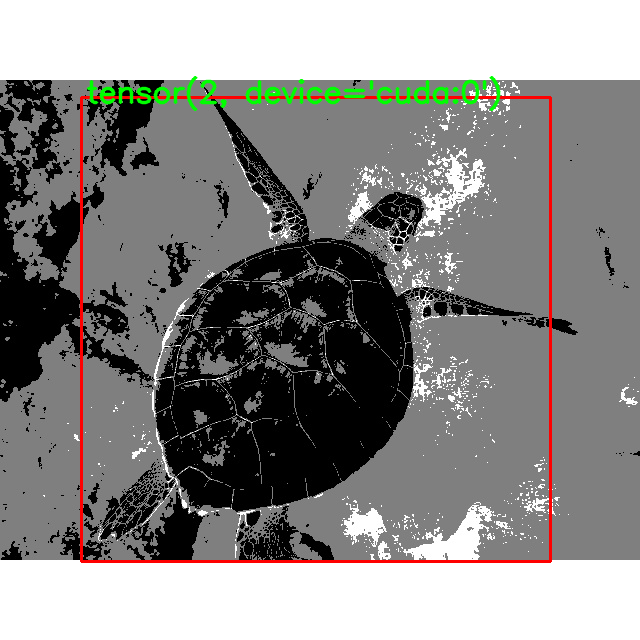

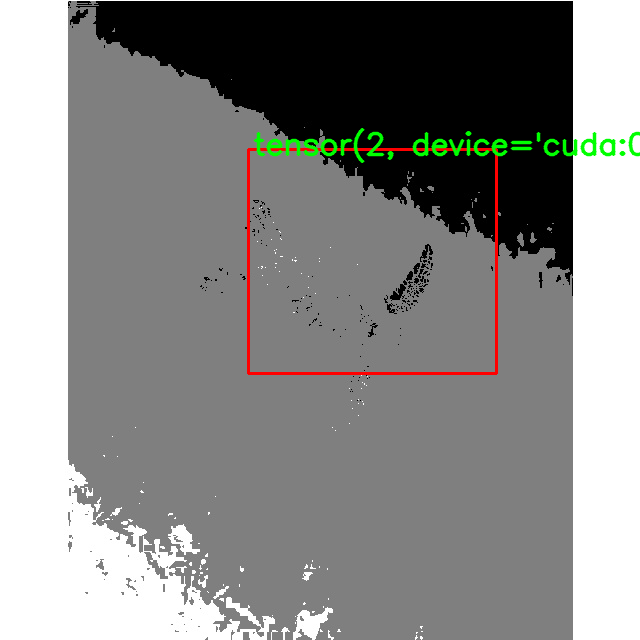

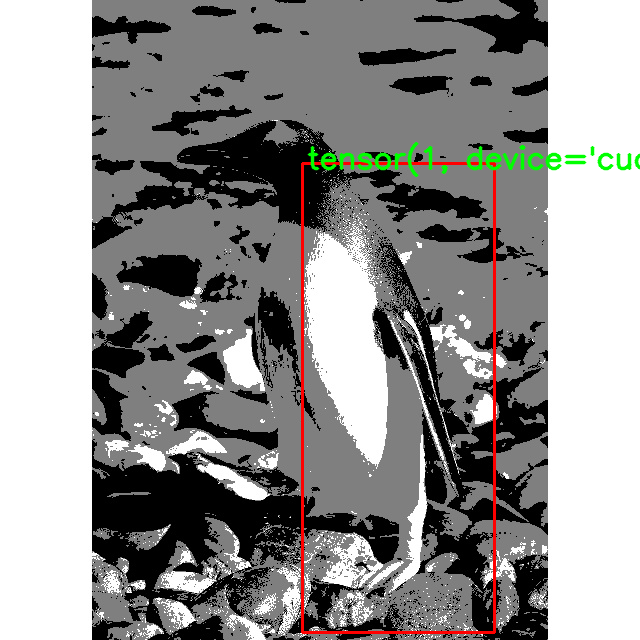

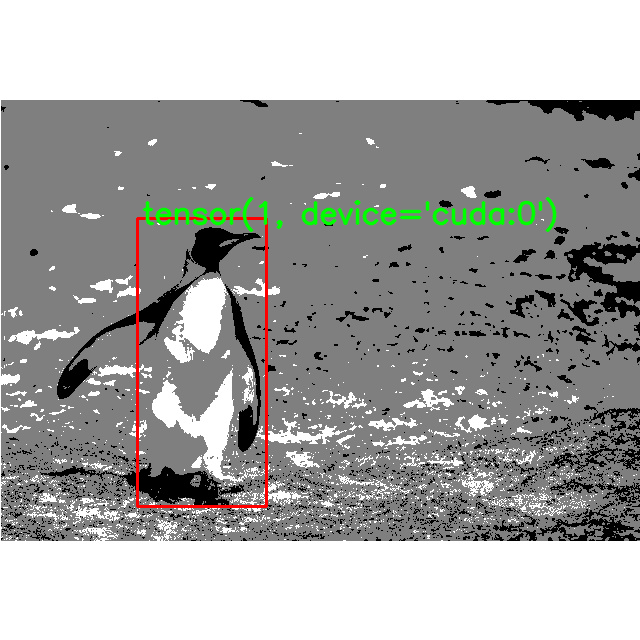

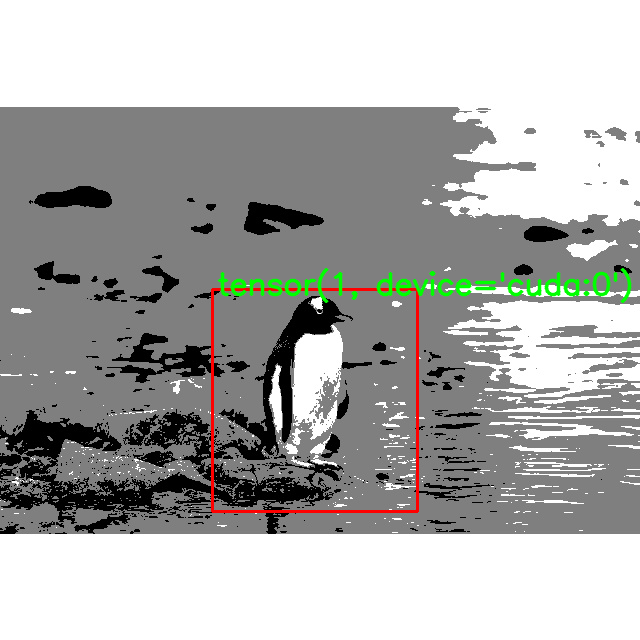

Loss: 448.74053955078125


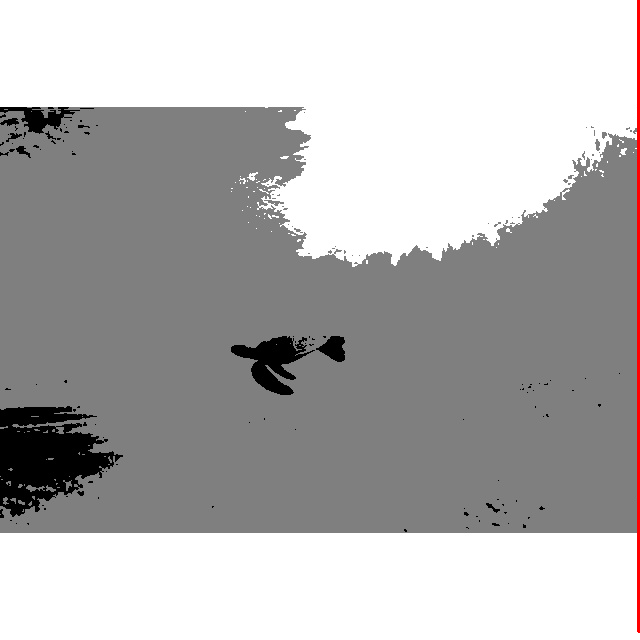

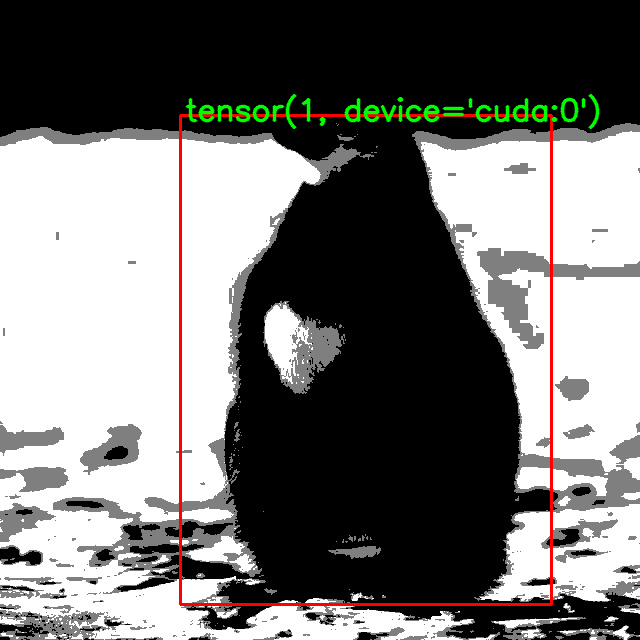

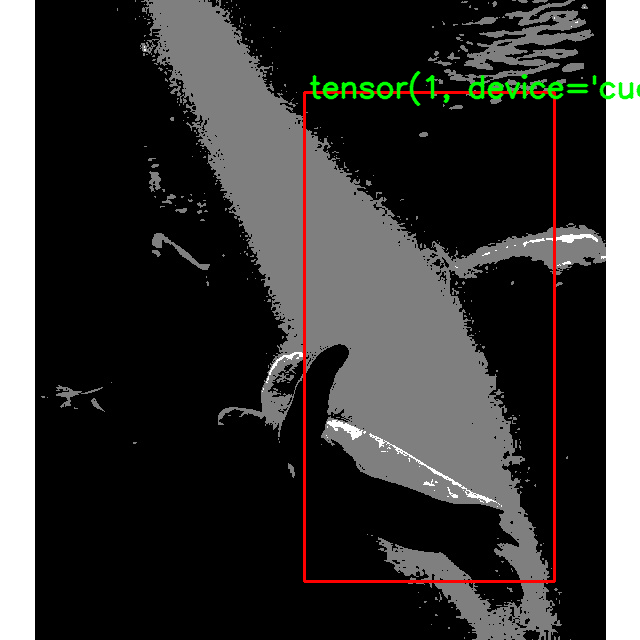

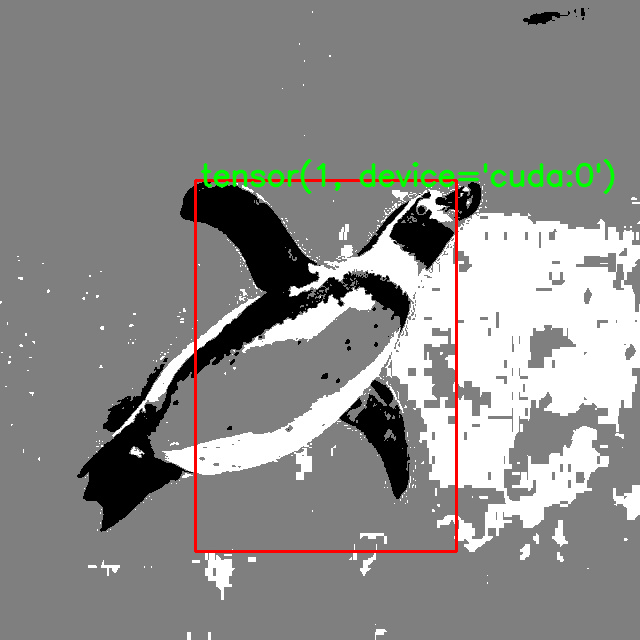

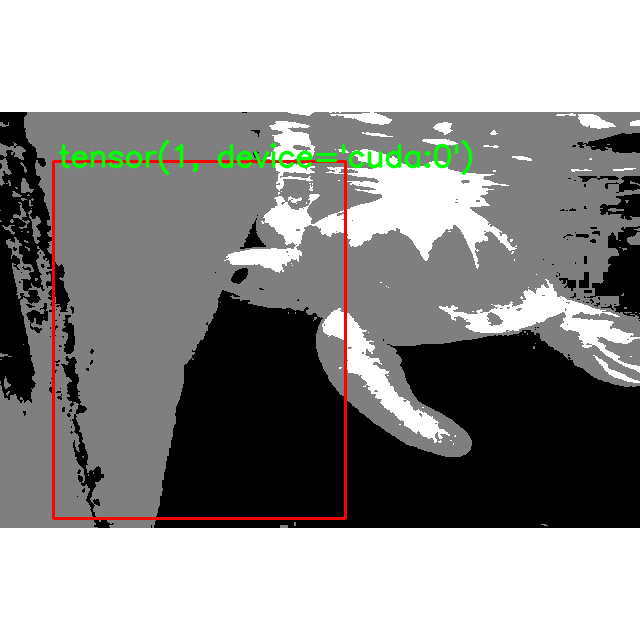

Loss: 321.3621826171875


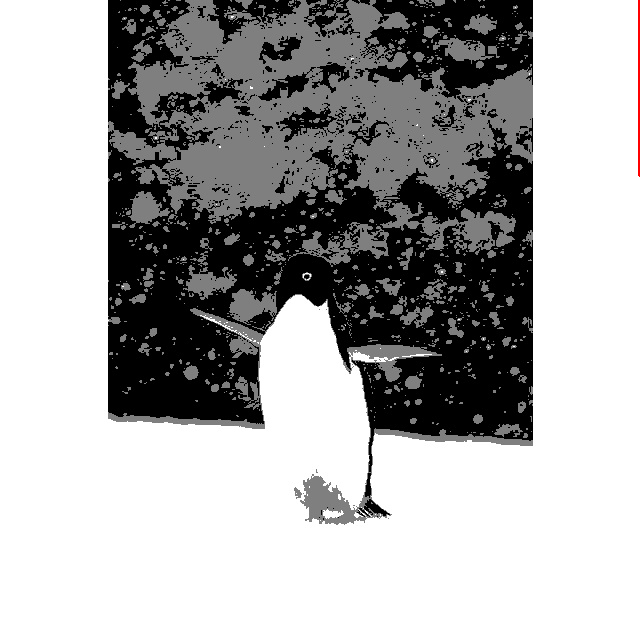

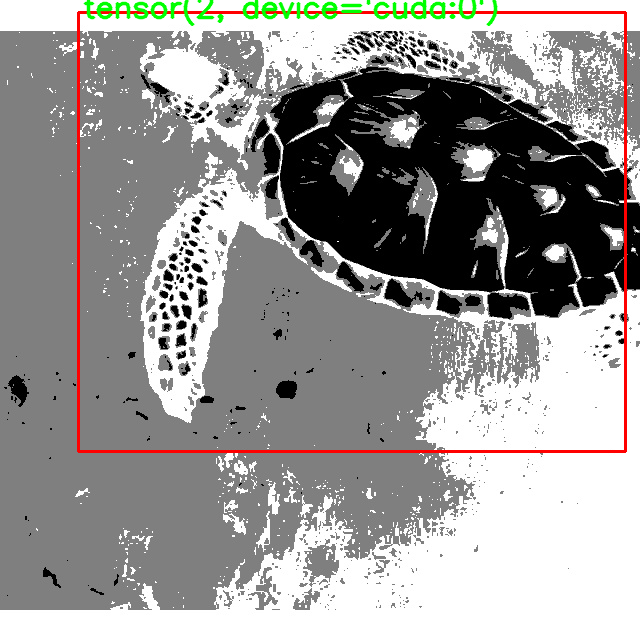

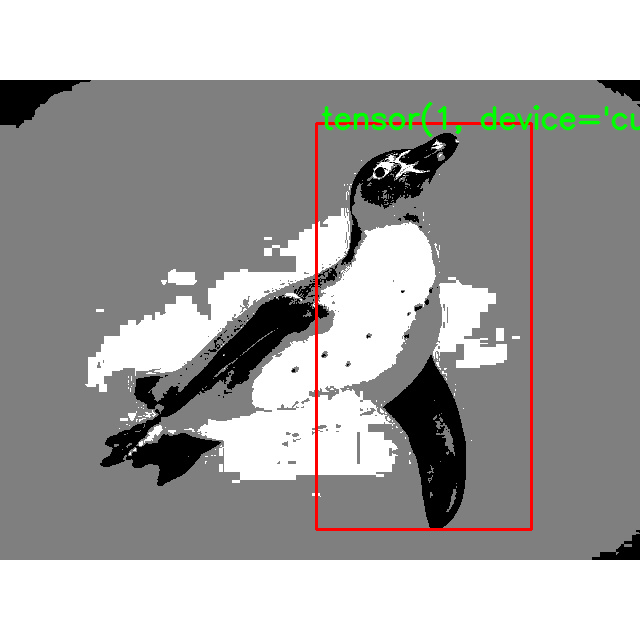

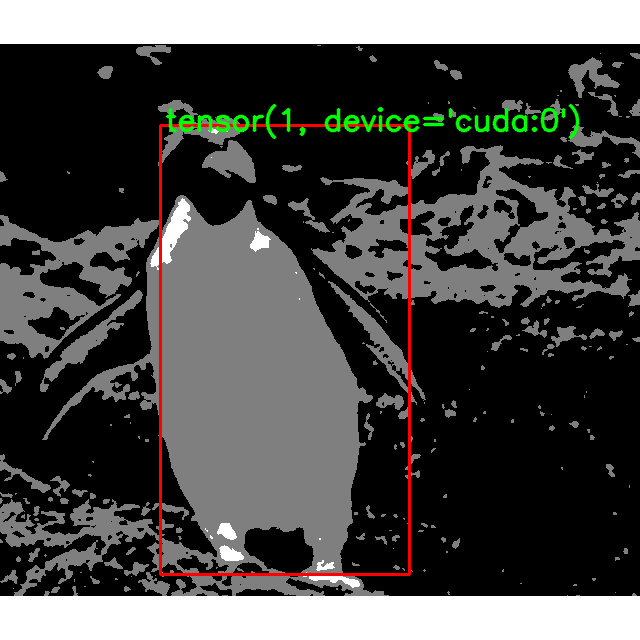

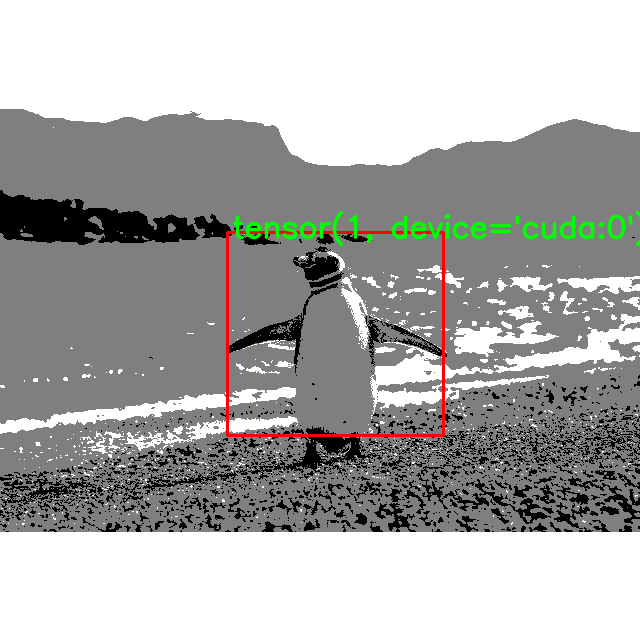

Loss: 303.185546875


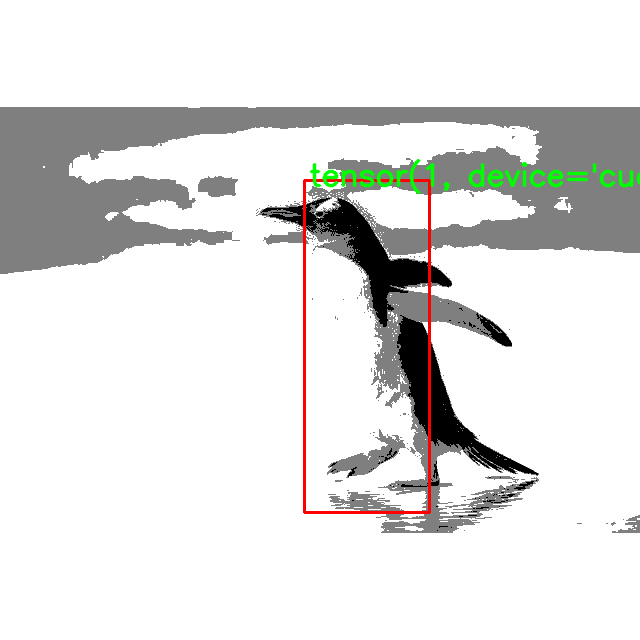

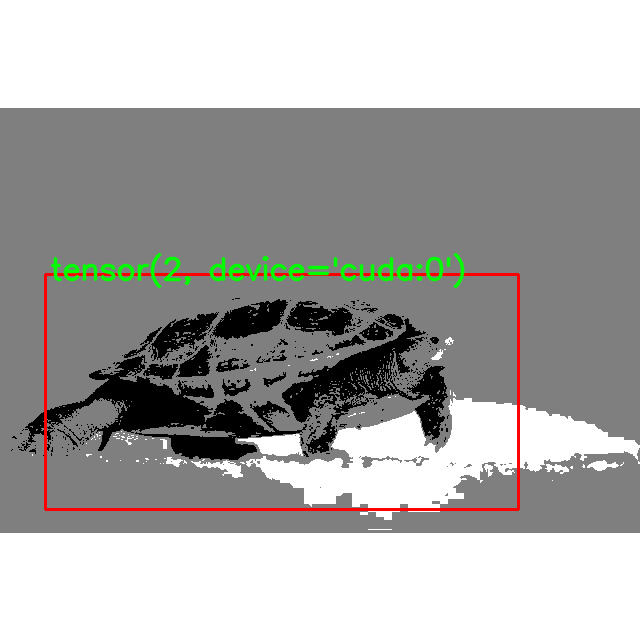

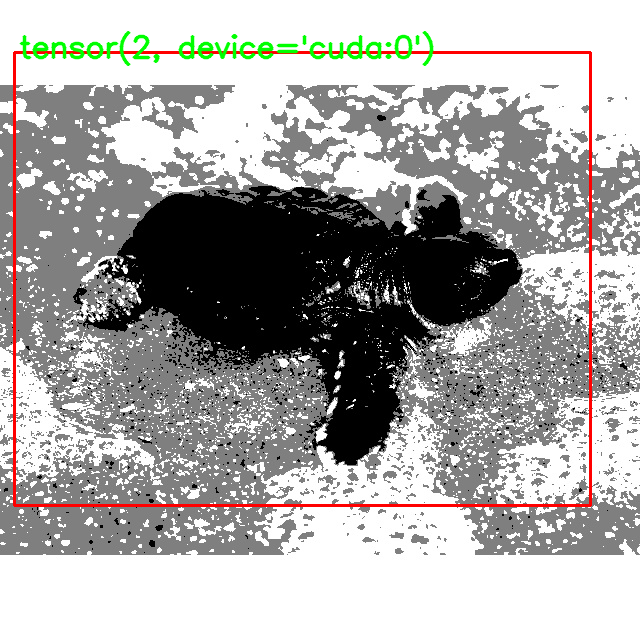

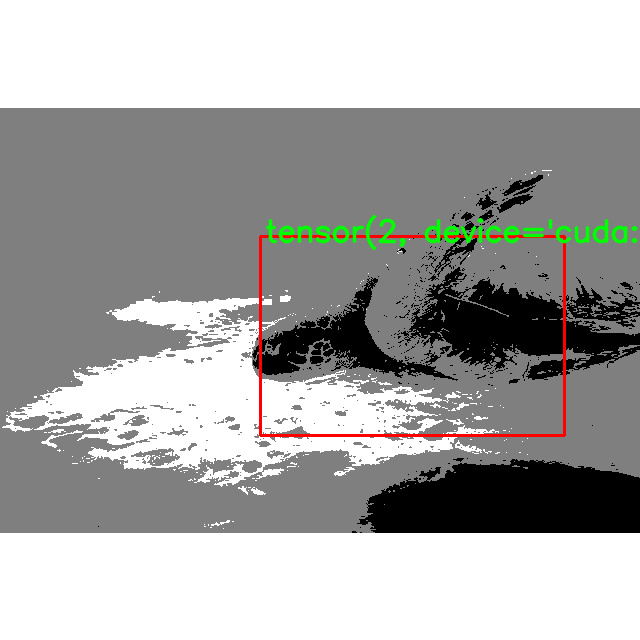

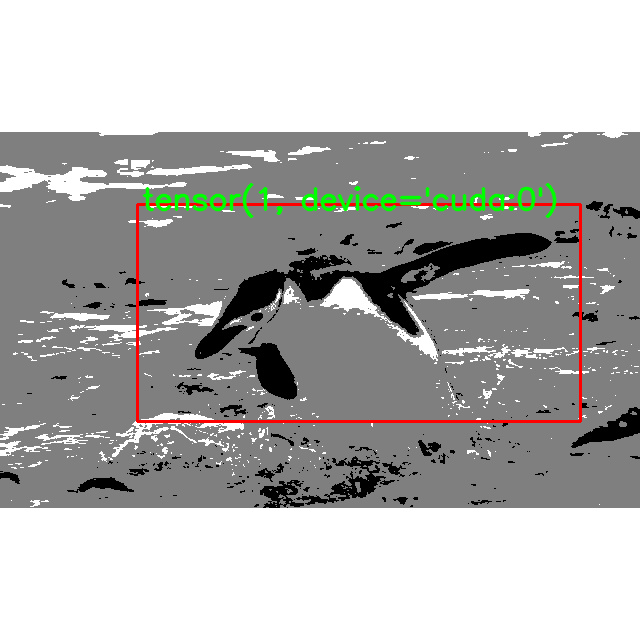

Loss: 247.31460571289062


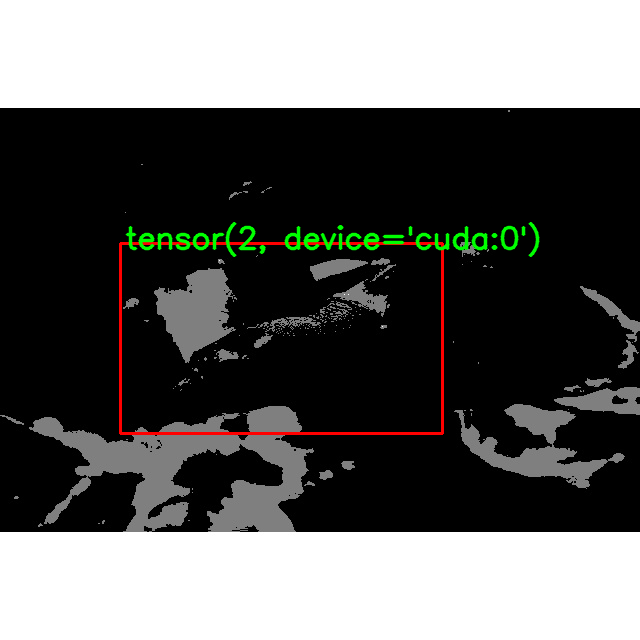

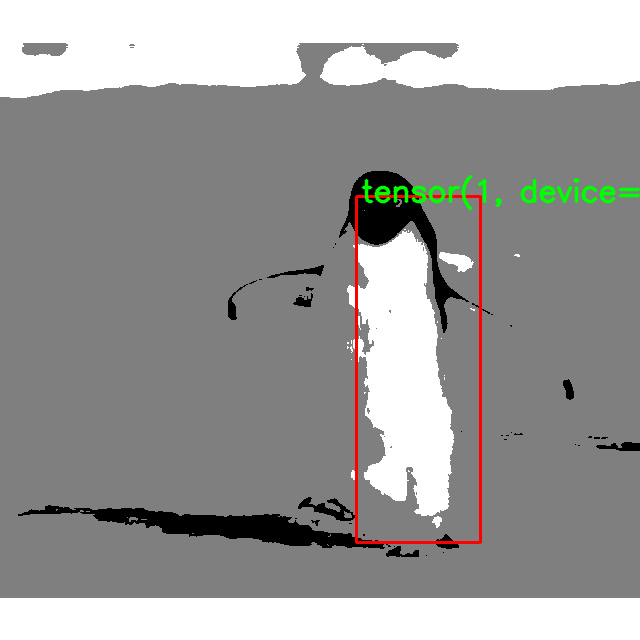

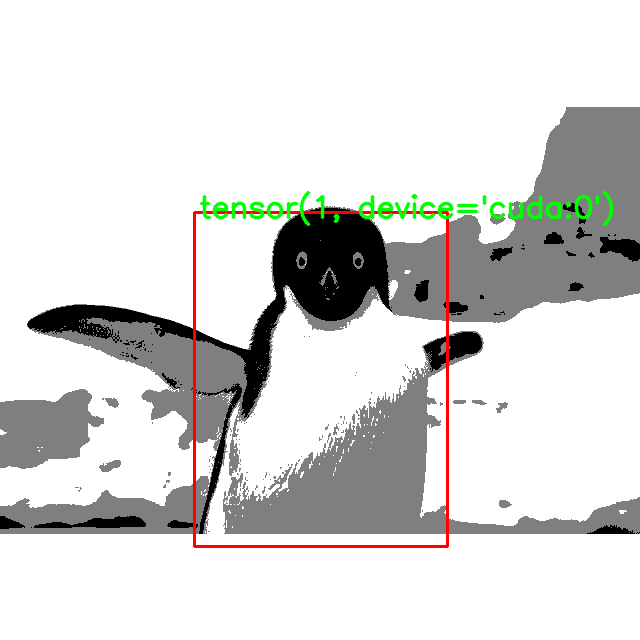

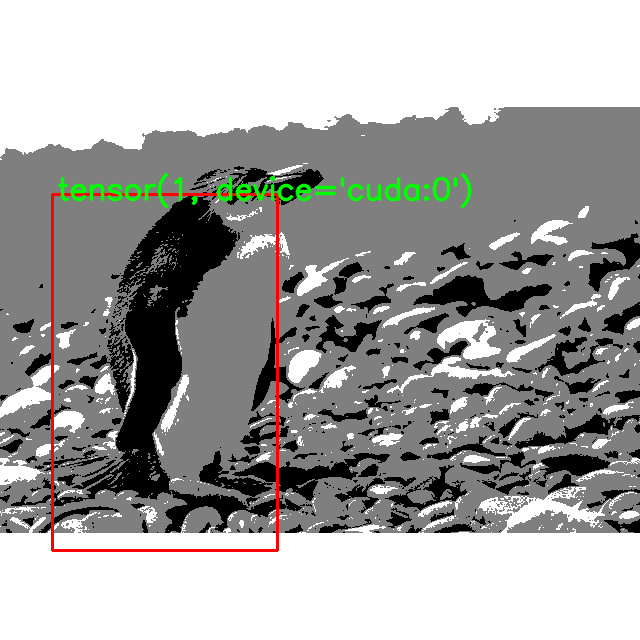

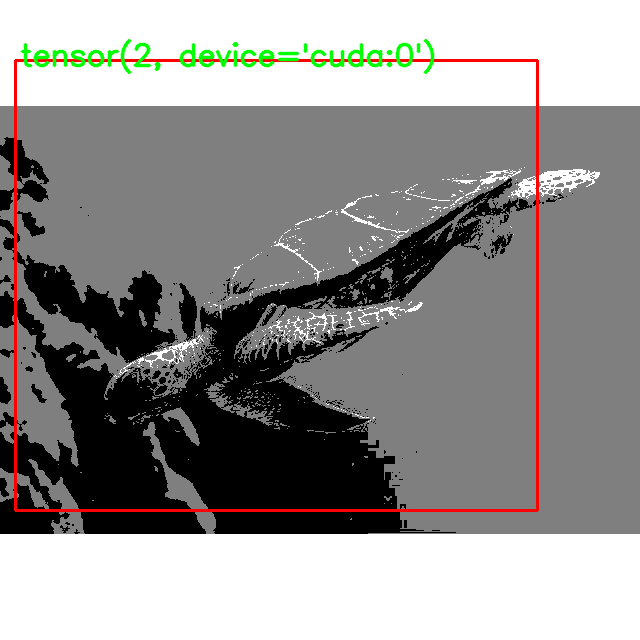

Loss: 444.9582214355469


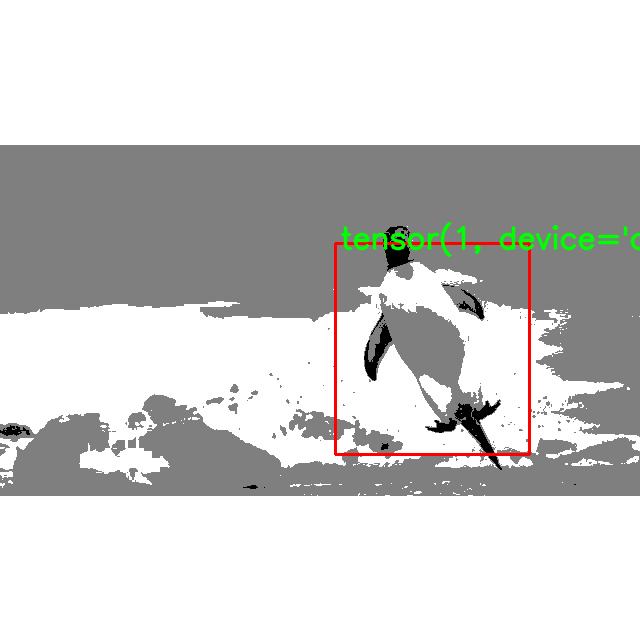

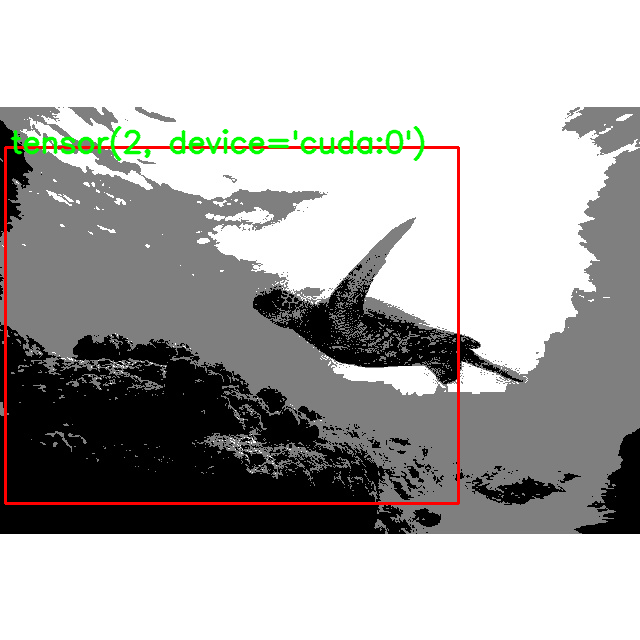

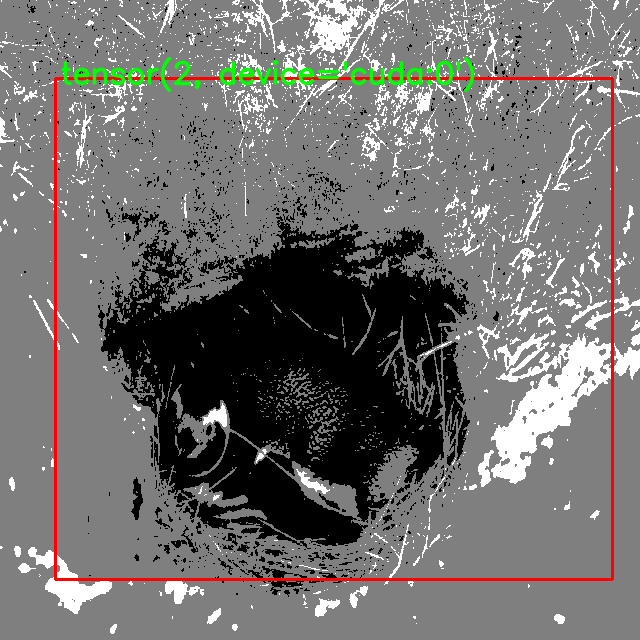

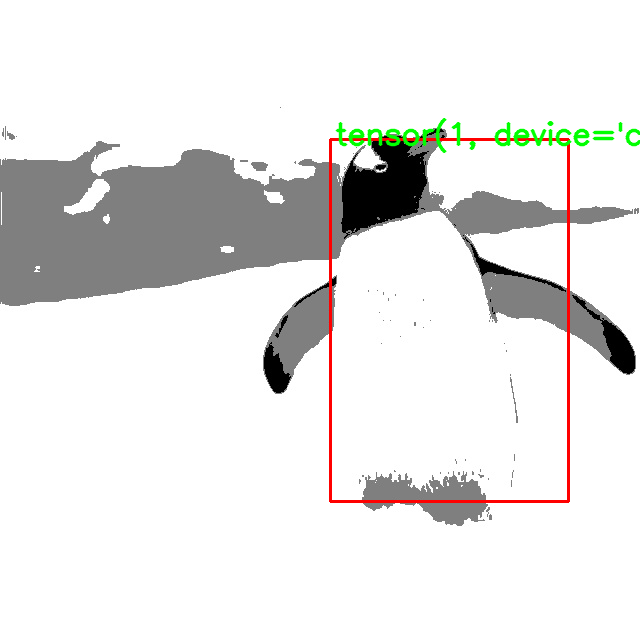

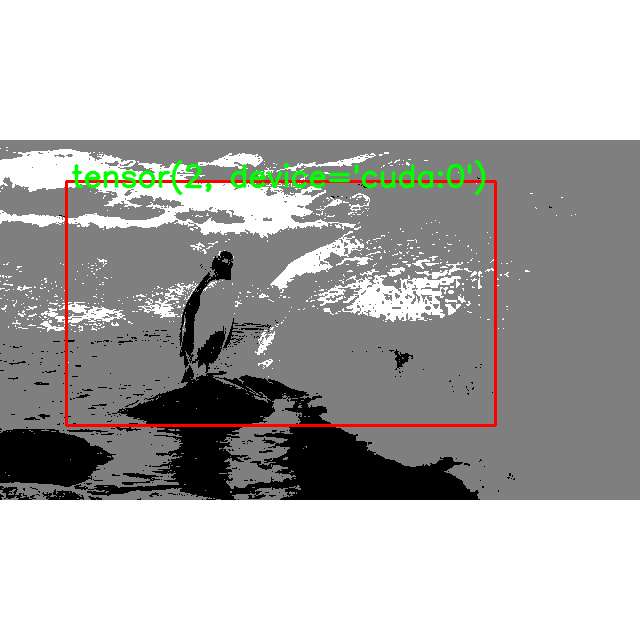

Loss: 358.3792419433594


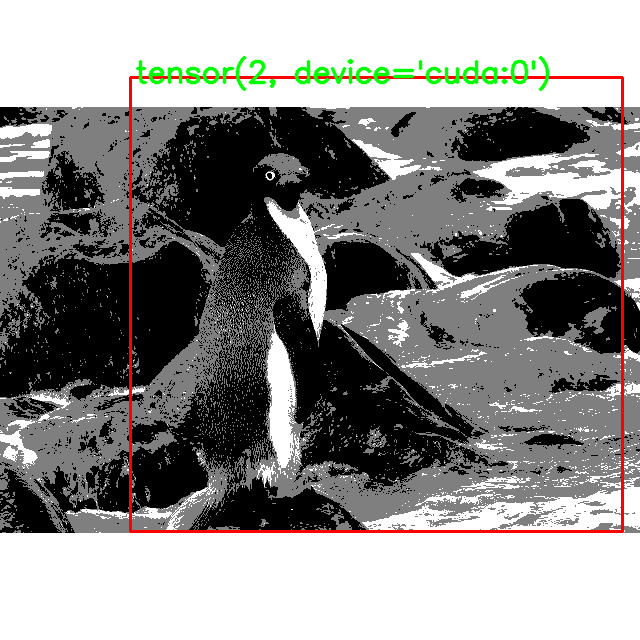

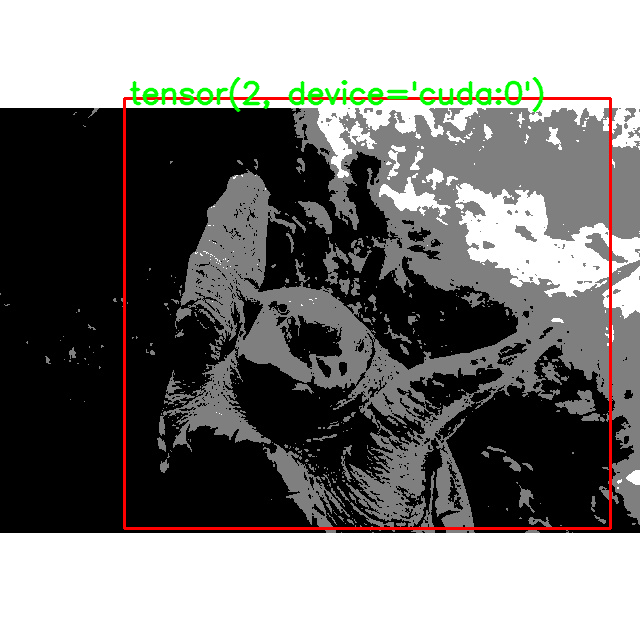

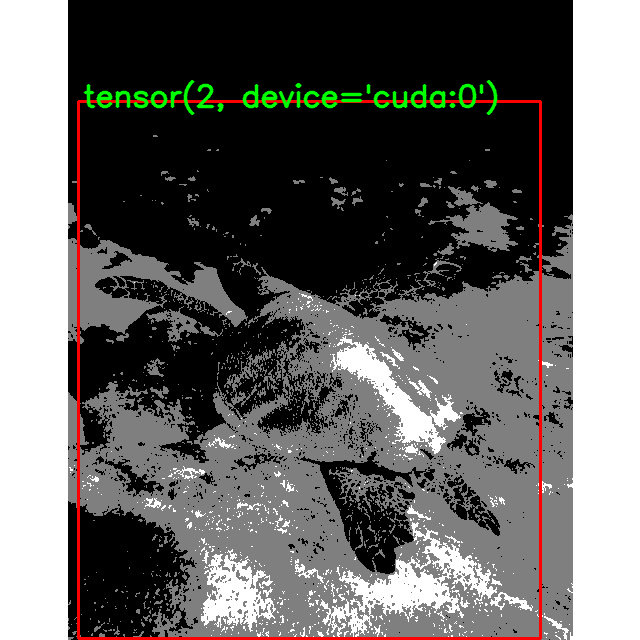

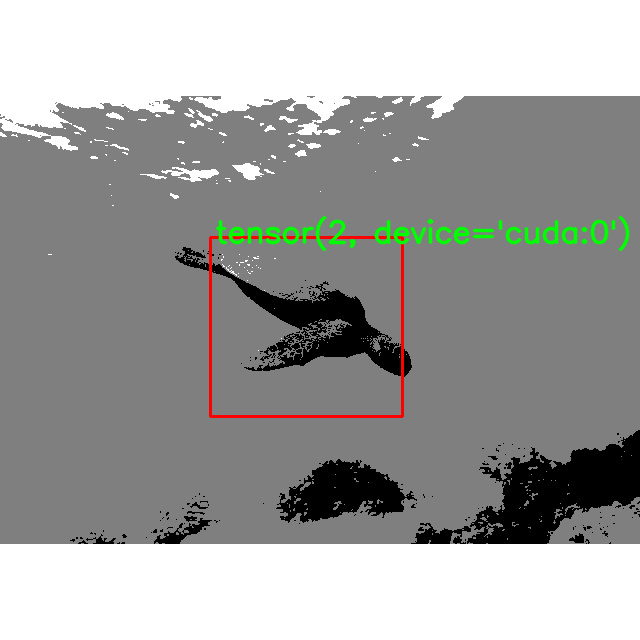

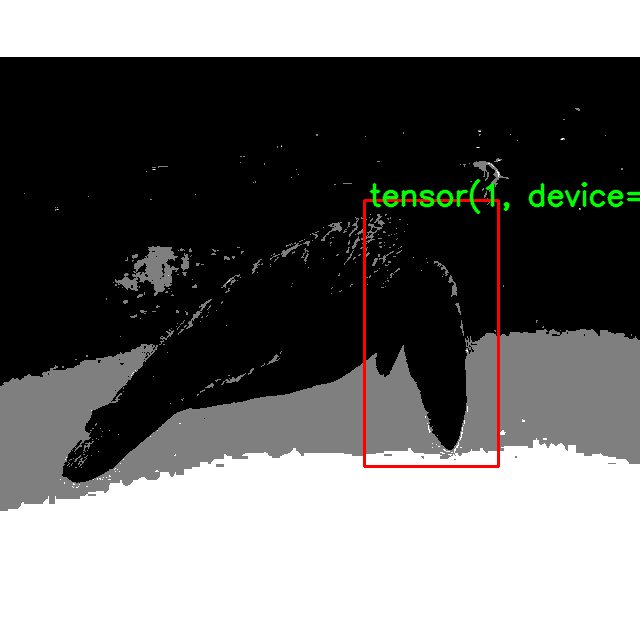

In [ ]:
def loss_cul(boxes,targets):
  sum=0
  num=0
  for box,target in zip(boxes,targets):
    sum+=torch.dist(box,target["bbox"])
    num+=1
  return sum/num
test_dataset = CocoDetection(root='/content/drive/MyDrive/9517_augmented/valid/preprocess', annFile='/content/drive/MyDrive/9517_augmented/valid.json', transforms=transform)
model.eval()
test_sampler=torch.utils.data.RandomSampler(test_dataset)
batch_sampler=torch.utils.data.BatchSampler(test_sampler,5,drop_last=True)
test_dataloader = DataLoader(test_dataset, batch_sampler=batch_sampler, num_workers=2,collate_fn=collate_fn_coco)
for images, targets in test_dataloader:
  images = [image.to(device) for image in images]
  predictions = model(images)
  targets=[target[0] for target in targets]
  for target in targets:
    xmin,ymin,width,height=target["bbox"]
    ymax=ymin+height
    xmax=xmin+width
    target["boxes"]=torch.tensor(np.expand_dims(np.array([xmin,ymin,xmax,ymax]),axis=0)).to(device)
    target["labels"]=torch.tensor(np.expand_dims(np.array(target["category_id"]),axis=0)).to(device)
    target["bbox"]=torch.tensor(target["bbox"]).to(device)
  boxes=[prediction["boxes"].to(device)for prediction in predictions]
  #print(predictions)
  labelss=[prediction["labels"]for prediction in predictions]
  mark=[]
  for i in range(len(boxes)):
    if len(boxes[i]>0):
      boxes[i]=boxes[i][0]
      labelss[i]=labelss[i][0]
      mark.append(1)
    else:
      mark.append(0)
  loss=loss_cul(boxes,targets)
  #loss = sum(criterion(box, target['bbox']) for box, target in zip(boxes, targets))
  print(f"Loss: {loss.item()}")
  for i in range(len(images)):#72
    if mark[i]==0:
      continue
    img=images[i]
    target=targets[i]
    img = img.cpu().permute(1, 2, 0).numpy()
    img = (img * 255).astype(np.uint8)
    img = cv2.cvtColor(img,cv2.COLOR_RGB2BGR)
    id=labelss[i]
    box=boxes[i]
    x1 = int(box[0])
    y1 = int(box[1])
    x2 = int(box[2])
    y2 = int(box[3])
    cv2.rectangle(img,(x1,y1),(x2,y2),(0,0,255),thickness=2)
    cv2.putText(img, text=str(id), org=(x1 + 5, y1 + 5), fontFace=font, fontScale=1,
      thickness=2, lineType=cv2.LINE_AA, color=(0, 255, 0))
    cv2_imshow(img)
    cv2.waitKey()



In [ ]:
#print(predictions)